# 231005 - Enrichment over 2-cell H3K27me3 ChIP-seq domains

In [1]:
import numpy as np
import pandas as pd
import h5py
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.notebook import tqdm
from glob import glob
from scipy.signal import gaussian, fftconvolve
from matplotlib import gridspec
from scipy import signal
from scipy import stats

rs = np.random.RandomState()
rs.seed(42)

import sys
sys.path.append('../../combining_all_data/bin/')
sys.path.append('../bin/')
from preimplantation_toolkit import *
import preimplantation_load_data as ld

In [2]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

FIGOUTDIR = '../output/figures/6_Preimplantation.EED_mKO_experiments.part2.enirchment_over_H3K27me3_domains/'

In [3]:
! mkdir -p $FIGOUTDIR || true;

In [4]:
HOME = '/Users/f.rang/surfdrive/Kind/data/'

BINSIZE = 10000
MINMAP_PER_KB = 1
MINMAP = int(MINMAP_PER_KB * BINSIZE / 1000)

ANNOFN = HOME + 'projects/preimplantation/combining_all_data/metadata/FR230814.samplesheet.tsv'
COLORFN = '../colors/manuscript_colors.tsv'

# DamID file names
COUNTS = '../../combining_all_data/data/damid_counts/FR230814.DamID.sample_counts.{construct}.all_stages.{genotype}.damid_pass.binsize_{binsize:d}.hdf5'
BINARY = '../../combining_all_data/data/damid_binary/FR230814.DamID.sample_smooth_binary.{construct}.all_stages.{genotype}.damid_pass.binsize_{binsize:d}.hdf5'
CONTFC = '../../combining_all_data/data/damid_CF/FR230814.DamID.contact_frequency.{construct}.{stage}.{treatment}.{genotype}.damid_pass.binsize_{binsize:d}.hdf5'
INSILICO = '../../combining_all_data/data/damid_insilico/FR230814.DamID.insilico_counts.{construct}.{stage}.{treatment}.{genotype}.{sample}_samples.damid_pass.binsize_{binsize:d}.hdf5'
ALLELEFILTFN = '../../combining_all_data/data/damid_allelic_filter/FR230814.allelic_filter_based_on_visibility_and_bias.{genotype}.binsize_{binsize:d}.hdf5'

# Bin clustering
indir = '../output/figures/5.2_Preimplantation.simplified_bin_clustering.part1.Performing_clustering.allelic_bias_correction/'
BIN_CLUSTER_FN = indir + 'FR231103.clustering_of_bins.binsize_100000.tsv'

# DamID mappability
MAPFN = HOME + "references/mouse/mm10/mappability/Mus_musculus.GRCm38.dna.primary_assembly.with_ERCC.GATC.bowtie2_very_sensitive_N1.readlength_65.counts.pos.hdf5"
POSFN = HOME + "references/mouse/mm10/mappability/Mus_musculus.GRCm38.dna.primary_assembly.with_ERCC.GATC.posarray.hdf5"

# 1. Loading Kind data

In [5]:
color_dict = ld.load_color_dict(COLORFN)

## 1.1 Loading samplesheet

In [6]:
stage_order = ['zygote', '2cell', '8cell', 'mESC']
chrom_order = [str(c) for c in range(1,20)] + ['X', 'Y']
treatment_order = [
    'no_treatment', 'EED_ctrl', 'EED_mKO', 'Cbx7(CD)-Lap2b', 'Lap2b'
]

In [7]:
anno = pd.read_csv(ANNOFN, sep='\t')
anno = anno[anno['construct'] == 'Lmnb1'].reset_index(drop=True)
anno = anno[anno['stage'].isin(stage_order)]
anno = anno[anno.treatment.isin(treatment_order)]
anno = anno.set_index('damid_name')
anno = anno[anno.DamID_PASS]
anno = anno[anno.cellcount == 1]

In [8]:
anno.groupby(['stage', 'genotype', 'treatment']).size()

stage   genotype                treatment     
2cell   C57BL/6J_x_JF1/Ms       EED_ctrl           87
                                EED_mKO            54
        CBAB6F1_x_CAST/EiJ      Cbx7(CD)-Lap2b     39
                                Lap2b              11
                                no_treatment       26
        homozygous              Cbx7(CD)-Lap2b     28
                                Lap2b              31
                                no_treatment      197
8cell   CBAB6F1_x_CAST/EiJ      Cbx7(CD)-Lap2b     35
                                no_treatment       21
        homozygous              no_treatment      183
mESC    129S1/SvImJ_x_CAST/EiJ  no_treatment      268
zygote  CBAB6F1_x_CAST/EiJ      no_treatment       14
        homozygous              no_treatment      107
dtype: int64

__Generate a samplesheet for in silico populations__

In [9]:
anno_comb = anno[anno.DamID_PASS].groupby(['stage', 'fusion_construct', 'genotype', 'treatment', 'is_heterozygous']).size().reset_index().drop(columns=[0])
anno_comb['stage'] = pd.Categorical(anno_comb['stage'], categories=['zygote', '2cell', '8cell', 'morula', 'early_blastocyst', 'mESC'])
anno_comb['is_singlecell'] = True
anno_comb.loc[anno_comb.stage.isin(['morula', 'early_blastocyst']), 'is_singlecell'] = False
anno_comb = anno_comb.sort_values(by=['stage', 'is_heterozygous', 'genotype', 'treatment'])
anno_comb

,stage,fusion_construct,genotype,treatment,is_heterozygous,is_singlecell
13,zygote,Dam-Lmnb1,homozygous,no_treatment,False,True
12,zygote,Dam-Lmnb1,CBAB6F1_x_CAST/EiJ,no_treatment,True,True
5,2cell,Dam-Lmnb1,homozygous,Cbx7(CD)-Lap2b,False,True
6,2cell,Dam-Lmnb1,homozygous,Lap2b,False,True
7,2cell,Dam-Lmnb1,homozygous,no_treatment,False,True
0,2cell,Dam-Lmnb1,C57BL/6J_x_JF1/Ms,EED_ctrl,True,True
1,2cell,Dam-Lmnb1,C57BL/6J_x_JF1/Ms,EED_mKO,True,True
2,2cell,Dam-Lmnb1,CBAB6F1_x_CAST/EiJ,Cbx7(CD)-Lap2b,True,True
3,2cell,Dam-Lmnb1,CBAB6F1_x_CAST/EiJ,Lap2b,True,True
4,2cell,Dam-Lmnb1,CBAB6F1_x_CAST/EiJ,no_treatment,True,True


## 1.2 Loading mappability

In [10]:
GENOTYPE2PARENT = {
    '129S1/SvImJ_x_CAST/EiJ': {
        'maternal': 'unique_129S1_SvImJ_snps',
        'paternal': 'unique_CAST_EiJ_snps'
    },
    
    'CBAB6F1_x_CAST/EiJ': {
        'maternal': 'unique_CBABL6F1_snps',
        'paternal': 'unique_CAST_snps'
    },
    
    'C57BL/6J_x_JF1/Ms': {
        'maternal': 'unique_C57BL_6J_snps',
        'paternal': 'unique_JF1_Ms_snps'
    }
}

In [11]:
mapab = ld.load_mappability(POSFN, MAPFN, chrom_order, BINSIZE)

In [12]:
mapab_gt = ld.load_mapab_from_count_file_heterozygous(COUNTS, anno, BINSIZE, GENOTYPE2PARENT, chrom_order)

## 1.3 Loading data

__Sample counts__

In [13]:
# damid_counts = ld.load_sample_damid_counts_heterozygous(COUNTS, anno, BINSIZE, GENOTYPE2PARENT, chrom_order)

__Binary sample counts__

In [14]:
# damid_binary = ld.load_sample_damid_binary_heterozygous(BINARY, anno, BINSIZE, GENOTYPE2PARENT, chrom_order)

__Contact Frequency__

In [15]:
if BINSIZE >= 100000:
    contact_freq =  {p: dict() for p in ['maternal', 'paternal', 'combined']}

    for info, df in anno.groupby(['fusion_construct', 'stage', 'genotype', 'treatment', 'is_heterozygous']):

        # load combined
        gt_name = info[2] if not info[-1] else info[2].replace('/','') + '.combined'
        fn = CONTFC.format(construct = info[0], stage = info[1], treatment = info[3], genotype = gt_name, binsize=BINSIZE)
        name = (info[1], info[2], info[3])

        if len(glob(fn)) == 0:
            print('CF does not exist for', info)
            continue

        contact_freq['combined'][name] =  load_count_file(fn)

        if info[-1]:
            for parent, gt in GENOTYPE2PARENT[info[2]].items():
                gt_name = info[2].replace('/','') + '.' + gt
                fn = CONTFC.format(construct = info[0], stage = info[1], treatment = info[3], genotype = gt_name, binsize=BINSIZE)
                contact_freq[parent][name] =  load_count_file(fn)

__in silico populations__

In [16]:
damid_insilico = {p: dict() for p in ['maternal', 'paternal', 'combined']}

for info, df in anno.groupby(['fusion_construct', 'stage', 'genotype', 'treatment', 'is_heterozygous']):
    
    assert len(anno.fusion_construct.unique()) == 1
    
    # load combined
    gt_name = info[2] if not info[-1] else info[2].replace('/','') + '.combined'
    fn = INSILICO.format(
        construct = info[0], stage = info[1], treatment = info[3], 
        sample = '1cell', genotype = gt_name, binsize=BINSIZE
    )
    fns = glob(fn)
    print(info, len(fns))
    name = (info[1], info[2], info[3])
    
    for fn in fns:
        counts = load_count_file(fn)
        counts = {c: counts[c].astype(int) for c in chrom_order}
        
        if name in damid_insilico['combined']:
            damid_insilico['combined'][name] = {c: damid_insilico['combined'][name][c] + counts[c] for c in chrom_order}
        else:
            damid_insilico['combined'][name] = counts

    # load parental
    if info[-1]:
        for parent, gt in GENOTYPE2PARENT[info[2]].items():
            gt_name = info[2].replace('/','') + '.' + gt
            fn = INSILICO.format(
                construct = info[0], stage = info[1], treatment = info[3], 
                sample = '1cell', genotype = gt_name, binsize=BINSIZE
            )
            fns = glob(fn)
            
            for fn in fns:
                counts =  load_count_file(fn)
                counts = {c: counts[c].astype(int) for c in chrom_order}

                if name in damid_insilico[parent]:
                    damid_insilico[parent][name] = {c: damid_insilico[parent][name][c] + counts[c] for c in chrom_order}
                else:
                    damid_insilico[parent][name] = counts
                

('Dam-Lmnb1', '2cell', 'C57BL/6J_x_JF1/Ms', 'EED_ctrl', True) 1
('Dam-Lmnb1', '2cell', 'C57BL/6J_x_JF1/Ms', 'EED_mKO', True) 1
('Dam-Lmnb1', '2cell', 'CBAB6F1_x_CAST/EiJ', 'Cbx7(CD)-Lap2b', True) 1
('Dam-Lmnb1', '2cell', 'CBAB6F1_x_CAST/EiJ', 'Lap2b', True) 1
('Dam-Lmnb1', '2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment', True) 1
('Dam-Lmnb1', '2cell', 'homozygous', 'Cbx7(CD)-Lap2b', False) 1
('Dam-Lmnb1', '2cell', 'homozygous', 'Lap2b', False) 1
('Dam-Lmnb1', '2cell', 'homozygous', 'no_treatment', False) 1
('Dam-Lmnb1', '8cell', 'CBAB6F1_x_CAST/EiJ', 'Cbx7(CD)-Lap2b', True) 1
('Dam-Lmnb1', '8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment', True) 1
('Dam-Lmnb1', '8cell', 'homozygous', 'no_treatment', False) 1
('Dam-Lmnb1', 'mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment', True) 1
('Dam-Lmnb1', 'zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment', True) 1
('Dam-Lmnb1', 'zygote', 'homozygous', 'no_treatment', False) 1


__RPKM normalization of _in silico_ populations__

In [17]:
damid_insilico_rpkm = {p: dict() for p in ['maternal', 'paternal', 'combined']}

# Normalize DamID data
for _, row in anno_comb.iterrows():
    sample = (row['stage'], row['genotype'], row['treatment'])
    gt = row['genotype']
    
    for parent in damid_insilico:
        if sample not in damid_insilico[parent]:
            print(parent, sample)
            continue


        if parent in ['maternal', 'paternal']:
            dm = sum([damid_insilico['maternal'][sample][c].sum() for c in chrom_order])
            dp = sum([damid_insilico['paternal'][sample][c].sum() for c in chrom_order])
            d = dm + dp

            counts = damid_insilico[parent][sample]
            damid_insilico_rpkm[parent][sample] = rpkm_normalize(counts, binsize=BINSIZE, depth=d)

        else:
            counts = damid_insilico[parent][sample]
            damid_insilico_rpkm[parent][sample] = rpkm_normalize(counts, binsize=BINSIZE)



maternal ('zygote', 'homozygous', 'no_treatment')
paternal ('zygote', 'homozygous', 'no_treatment')
maternal ('2cell', 'homozygous', 'Cbx7(CD)-Lap2b')
paternal ('2cell', 'homozygous', 'Cbx7(CD)-Lap2b')
maternal ('2cell', 'homozygous', 'Lap2b')
paternal ('2cell', 'homozygous', 'Lap2b')
maternal ('2cell', 'homozygous', 'no_treatment')
paternal ('2cell', 'homozygous', 'no_treatment')
maternal ('8cell', 'homozygous', 'no_treatment')
paternal ('8cell', 'homozygous', 'no_treatment')


__log2OE normalization of _in silico_ populations__

In [18]:
damid_insilico_logoe = {p: dict() for p in ['maternal', 'paternal', 'combined']}

# RPKM normalize mappability data
mapab_rpkm = dict()
for gt in mapab_gt:
    mapab_rpkm[gt] = dict()
    
    for p in mapab_gt[gt]:
        m = mapab_gt[gt][p]
        
        if p in ['maternal', 'paternal']:
            dm = sum([mapab_gt[gt]['maternal'][c].sum() for c in chrom_order])
            dp = sum([mapab_gt[gt]['paternal'][c].sum() for c in chrom_order])
            d = dm+dp
            m = rpkm_normalize(m, binsize=BINSIZE, depth=d)
        else:
            m = rpkm_normalize(m, binsize=BINSIZE)
            
        mapab_rpkm[gt][p] = m

std = 10000
W = gaussian(np.ceil(std / BINSIZE * 6 / 2) * 2 + 1, std / BINSIZE)
W /= W.sum()

# Normalize DamID data
for _, row in anno_comb.iterrows():
    sample = (row['stage'], row['genotype'], row['treatment'])
    gt = row['genotype']
    
    for parent in damid_insilico:
        if sample not in damid_insilico[parent]:
            print(sample)
            continue
            
#         if (row['stage'] == 'zygote') and (row['is_heterozygous']):
        rpkm = damid_insilico_rpkm[parent][sample]
        rpkm = {c: np.copy(rpkm[c]) for c in rpkm}
        rpkm = {c: fftconvolve(rpkm[c], W, mode='same') for c in rpkm}

        m = mapab_rpkm[gt][parent]
        m = {c: np.copy(m[c]) for c in m}
        m = {c: fftconvolve(m[c], W, mode='same') for c in m}

        damid_insilico_logoe[parent][sample] = {c: np.log2( (rpkm[c] + .1) / (m[c] + .1) ) for c in chrom_order}

#         else:
#             rpkm = damid_insilico_rpkm[parent][sample]
#             damid_insilico_logoe[parent][sample] = {c: np.log2( (rpkm[c] + .1) / (mapab_rpkm[gt][parent][c] + .1) ) for c in chrom_order}


('zygote', 'homozygous', 'no_treatment')
('zygote', 'homozygous', 'no_treatment')
('2cell', 'homozygous', 'Cbx7(CD)-Lap2b')
('2cell', 'homozygous', 'Cbx7(CD)-Lap2b')
('2cell', 'homozygous', 'Lap2b')
('2cell', 'homozygous', 'Lap2b')
('2cell', 'homozygous', 'no_treatment')
('2cell', 'homozygous', 'no_treatment')
('8cell', 'homozygous', 'no_treatment')
('8cell', 'homozygous', 'no_treatment')


## 1.4 Loading allele visibility

In [19]:
allele_filt_gt = dict()

for gt in GENOTYPE2PARENT:
    
    fn = ALLELEFILTFN.format(genotype=gt.replace('/',''), binsize=BINSIZE)
    allele_filt_gt[gt] = dict()
    
    with h5py.File(fn, 'r') as f:
        for c in chrom_order:
            allele_filt_gt[gt][c] = f[c][:].astype(bool)
    
allele_filt_total = dict()

for c in chrom_order:
    filt = np.array([allele_filt_gt[gt][c] for gt in allele_filt_gt]).astype(int)
    filt = filt.sum(axis=0) == len(allele_filt_gt.keys())
    allele_filt_total[c] = filt

## 1.5 Loading bin clustering

In [20]:
bin_clusters = pd.read_table(BIN_CLUSTER_FN)
bin_clusters['chrom'] = bin_clusters['chrom'].astype(str)
bin_clusters.groupby('Kcluster').size()

Kcluster
1    4623
2    3910
3    3990
4    2141
5    2490
6    4558
dtype: int64

# 2. Loading Borsos DamID1 data

## 2.1 Loading samplesheet

In [21]:
fn = '../../GSE112551/metadata/FR200928.GSE112551.metadata.quality_stats.tsv'
dam1_anno = pd.read_table(fn)
dam1_anno = dam1_anno[(dam1_anno.treatment == 'no_treatment') & (dam1_anno.strain != 'CAST_female_x_C57BL_6NJ_male')]
dam1_anno = dam1_anno[dam1_anno.fusion_construct == 'Dam-LMNB1']
dam1_anno['stage_name'] = dam1_anno['stage'].values
dam1_anno['stage'] = dam1_anno['stage_name'].apply(func = lambda s: s.replace('_embryo', ''))

__Summarize samplesheet into distinct conditions__

In [22]:
dam1_comb = dam1_anno.groupby(['strain', 'fusion_construct', 'stage', 'stage_name', 'treatment', 'hybrid']).size().reset_index().drop(columns=0)
dam1_comb['sample'] = dam1_comb.apply(axis=1, func = lambda r: '%s:%s' % (r['stage'], r['fusion_construct']))

ind = dam1_comb['sample'].duplicated()
print(ind.sum())

0


In [23]:
dam1_comb['stage'] = pd.Categorical(dam1_comb.stage, categories = [
    'GV_oocyte',
    'pronucleus_maternal', 'pronucleus_paternal', 'zygote', 
    '2cell', '8cell',
    'ICM', 'TE', 'mESC'
])

dam1_comb = dam1_comb.sort_values(by='stage').reset_index(drop=True)
dam1_comb

,strain,fusion_construct,stage,stage_name,treatment,hybrid,sample
0,C57BL_6NJ,Dam-LMNB1,GV_oocyte,GV_oocyte,no_treatment,no,GV_oocyte:Dam-LMNB1
1,C57BL_6NJ,Dam-LMNB1,pronucleus_maternal,pronucleus_maternal,no_treatment,no,pronucleus_maternal:Dam-LMNB1
2,C57BL_6NJ,Dam-LMNB1,pronucleus_paternal,pronucleus_paternal,no_treatment,no,pronucleus_paternal:Dam-LMNB1
3,C57BL_6NJ_female_x_CAST_male,Dam-LMNB1,zygote,zygote,no_treatment,yes,zygote:Dam-LMNB1
4,C57BL_6NJ_female_x_CAST_male,Dam-LMNB1,2cell,2cell_embryo,no_treatment,yes,2cell:Dam-LMNB1
5,C57BL_6NJ_female_x_CAST_male,Dam-LMNB1,8cell,8cell_embryo,no_treatment,yes,8cell:Dam-LMNB1
6,C57BL_6NJ_female_x_CAST_male,Dam-LMNB1,ICM,ICM,no_treatment,yes,ICM:Dam-LMNB1
7,C57BL_6NJ_female_x_CAST_male,Dam-LMNB1,TE,TE,no_treatment,yes,TE:Dam-LMNB1
8,129S1_SvImJ_female_x_CAST_male,Dam-LMNB1,mESC,mESC,no_treatment,yes,mESC:Dam-LMNB1


## 2.2 Load data - _in silico_ populations of distinct biological conditions
Samples only differing in cellcount are merged.

In [24]:
from collections import defaultdict

In [25]:
FNFMT = '../../GSE112551/data/merged_hdf5/FR230814.GSE112551.{fusion}.{stage}.{treatment}.{strain}.{parent}.{norm}.binsize_{binsize:d}.hdf5'

__Load in silico populations__

In [26]:
dam1_insilico_counts = dict()
dam1_insilico_rpkm = dict()
dam1_insilico_logoe = dict()
tmp = {'combCOUNTS': dam1_insilico_counts, 'combRPKM': dam1_insilico_rpkm, 'combLog2OE': dam1_insilico_logoe}

assert len(dam1_comb.stage.unique()) == len(dam1_comb), 'Duplicate stages present, need additional criterium'

for norm, outdict in tmp.items():
    
    for allele in ['maternal', 'paternal', 'combined']:
        
        outdict[allele] = dict()
    
        for _, row in dam1_comb.iterrows():

            fn = FNFMT.format(fusion=row['fusion_construct'], stage=row['stage_name'], treatment=row['treatment'], strain=row['strain'], parent=allele, norm=norm, binsize=BINSIZE)
            fns = glob(fn)
            if len(fns) != 1:
                print('File not found (or multiple found?). Skipping.', fn)
                continue
            
            outdict[allele][row['stage']] = load_count_file(fns[0])

File not found (or multiple found?). Skipping. ../../GSE112551/data/merged_hdf5/FR230814.GSE112551.Dam-LMNB1.GV_oocyte.no_treatment.C57BL_6NJ.maternal.combCOUNTS.binsize_10000.hdf5
File not found (or multiple found?). Skipping. ../../GSE112551/data/merged_hdf5/FR230814.GSE112551.Dam-LMNB1.pronucleus_maternal.no_treatment.C57BL_6NJ.maternal.combCOUNTS.binsize_10000.hdf5
File not found (or multiple found?). Skipping. ../../GSE112551/data/merged_hdf5/FR230814.GSE112551.Dam-LMNB1.pronucleus_paternal.no_treatment.C57BL_6NJ.maternal.combCOUNTS.binsize_10000.hdf5
File not found (or multiple found?). Skipping. ../../GSE112551/data/merged_hdf5/FR230814.GSE112551.Dam-LMNB1.GV_oocyte.no_treatment.C57BL_6NJ.paternal.combCOUNTS.binsize_10000.hdf5
File not found (or multiple found?). Skipping. ../../GSE112551/data/merged_hdf5/FR230814.GSE112551.Dam-LMNB1.pronucleus_maternal.no_treatment.C57BL_6NJ.paternal.combCOUNTS.binsize_10000.hdf5
File not found (or multiple found?). Skipping. ../../GSE112551/da

__Load mappability__

In [27]:
FNFMT = '../../GSE112551/data/merged/FR230814.GSE112551.comb_counts.{strain}.{parent}.binsize_{binsize:d}.tsv.gz'

dam1_map = dict()
dam1_map_rpkm = dict()

for strain in dam1_anno['strain'].unique():
    
    dam1_map[strain] = dict()
    
    for allele in ['maternal', 'paternal', 'combined']:
        
        fn = FNFMT.format(strain=strain, parent=allele, binsize=BINSIZE)
        df = pd.read_table(fn, dtype={'chrom': str})

        col = list(filter(lambda c: c.startswith('mappability') and ('RPKM' not in c), df.columns.values))
        assert len(col) == 1
        bed = df[['chrom', 'start', 'end', col[0]]].copy()
        bed.columns = ['chrom', 'start', 'end', 'reads']
        M = convert_bedgraph_to_hdf5dict(bed, binsize=BINSIZE)
        dam1_map[strain][allele] = M
        
        col = list(filter(lambda c: c.startswith('mappability') and ('RPKM' in c), df.columns.values))
        assert len(col) == 1
        bed = df[['chrom', 'start', 'end', col[0]]].copy()
        bed.columns = ['chrom', 'start', 'end', 'reads']
        M = convert_bedgraph_to_hdf5dict(bed, binsize=BINSIZE)
        dam1_map[strain][allele] = M

__RPKM normalization of _in silico_ populations__

In [28]:
# dam1_insilico_rpkm = {p: dict() for p in ['maternal', 'paternal', 'combined']}

# # Normalize DamID data
# for _, row in dam1_comb.iterrows():
#     sample = row['sample']

#     for parent in dam1_data:
#         if sample not in dam1_data[parent]:
#             print(parent, sample)
#             continue


#         if parent in ['maternal', 'paternal']:
#             dm = sum([dam1_data['maternal'][sample][c].sum() for c in chrom_order])
#             dp = sum([dam1_data['paternal'][sample][c].sum() for c in chrom_order])
#             d = dm + dp

#             counts = dam1_data[parent][sample]
#             dam1_insilico_rpkm[parent][sample] = rpkm_normalize(counts, binsize=BINSIZE, depth=d)

#         else:
#             counts = dam1_data[parent][sample]
#             dam1_insilico_rpkm[parent][sample] = rpkm_normalize(counts, binsize=BINSIZE)

__log2OE normalization of _in silico_ populations__

In [29]:
# # RPKM normalize mappability data
# dam1_map_rpkm = dict()

# for parent in dam1_map:
#     dam1_map_rpkm[parent] = dict()
    
#     for sample in dam1_map[parent]:
        
#         m = {c: np.copy(dam1_map[parent][sample][c]) for c in chrom_order}

#         if parent in ['maternal', 'paternal']:
#             dm = sum([dam1_map['maternal'][sample][c].sum() for c in chrom_order])
#             dp = sum([dam1_map['paternal'][sample][c].sum() for c in chrom_order])
#             d = dm+dp
#             m = rpkm_normalize(m, binsize=BINSIZE, depth=d)
#         else:
#             m = rpkm_normalize(m, binsize=BINSIZE)

#         dam1_map_rpkm[parent][sample] = m

# # prepare smoothing kernel
# BORSOS_SMOOTH_STD = 10000
# W = gaussian(np.ceil(BORSOS_SMOOTH_STD / BINSIZE * 6 / 2) * 2 + 1, BORSOS_SMOOTH_STD / BINSIZE)
# W /= W.sum()

# # Normalize DamID data
# dam1_insilico_logoe = {p: dict() for p in ['maternal', 'paternal', 'combined']}
# dam1_insilico_logoe_smooth = {p: dict() for p in ['maternal', 'paternal', 'combined']}


# for _, row in dam1_comb.iterrows():
#     sample = row['sample']
    
#     for parent in dam1_insilico_rpkm:
#         if sample not in dam1_insilico_rpkm[parent]:
#             print(parent, sample)
#             continue
            
#         rpkm = dam1_insilico_rpkm[parent][sample]
#         rpkm = {c: np.copy(rpkm[c]) for c in chrom_order}
#         m = dam1_map_rpkm[parent][sample]
#         m = {c: np.copy(m[c]) for c in chrom_order}
        
#         dam1_insilico_logoe[parent][sample] = {c: np.log2( (rpkm[c] + .1) / (m[c] + .1) ) for c in chrom_order}
        
#         # smoooofffff
#         rpkm = {c: fftconvolve(rpkm[c], W, mode='same') for c in chrom_order}
#         m = {c: fftconvolve(m[c], W, mode='same') for c in chrom_order}
        
#         dam1_insilico_logoe_smooth[parent][sample] = {c: np.log2( (rpkm[c] + .1) / (m[c] + .1) ) for c in chrom_order}
        

# 3. Loading external data sets

In [30]:
FN = '../../combining_all_external_data/metadata/external_data_combined_samples.tsv'
ext_anno = pd.read_table(FN)
ext_anno = ext_anno[ext_anno.treatment == 'no']

samples = ext_anno.loc[ext_anno.target.isin(['H2AK119ub1', 'H3K27me3', 'H3K9me3', 'H3K4me3']), 'sample_id'].values
controls = ext_anno.loc[ext_anno.sample_id.isin(samples) & (ext_anno.control_id != 'none'), 'control_id'].values
samples = np.concatenate([samples, controls])
ext_anno = ext_anno[ext_anno.sample_id.isin(samples)]
ext_anno = ext_anno[~((ext_anno.dataset_id == 'GSE71434') & (ext_anno.target == 'H3K27me3'))]

select_stages = [
    'sperm', 'FG_oocyte', 'GV_oocyte', 'MII_oocyte', 
    'zygote', 'PN3_zygote', 'PN5_zygote', 
    '2cell_early', '2cell', '2cell_late',
    '4cell', '8cell', 'morula', 'blastocyst', 'ICM', 'mESC'
]
ext_anno = ext_anno[ext_anno.stage.isin(select_stages)]

ext_anno['stage'] = pd.Categorical(ext_anno['stage'], select_stages)

FNFMT = {
    'combined': '../../combining_all_external_data/data/binned/FR230828.external_data.RPKM.binsize_%d.tsv.gz',
    'maternal': '../../combining_all_external_data/data/binned/FR230828.external_data.allelic.unique_maternal.RPKM.binsize_%d.tsv.gz',
    'paternal': '../../combining_all_external_data/data/binned/FR230828.external_data.allelic.unique_paternal.RPKM.binsize_%d.tsv.gz',
    'allele_vis': '../../combining_all_external_data/data/binned/FR230828.external_data.allelic.allele_vis.fraction.binsize_%d.tsv.gz'
}

In [31]:
ext_data = {p: dict() for p in ['combined', 'maternal', 'paternal', 'allele_vis']}

for dat, fnfmt in FNFMT.items():
    fn = fnfmt % BINSIZE
    df = pd.read_table(fn, dtype={'chrom': str})
    
    for sample in ext_anno.sample_id.values:
        if sample not in df.columns:
            continue
            
        bed = df[['chrom', 'start', 'end', sample]].copy().rename(columns={sample: 'reads'})
        D = convert_bedgraph_to_hdf5dict(bed, binsize=BINSIZE)
        ext_data[dat][sample] = {c: D[c][:len(mapab[c])] for c in chrom_order}
        
    if dat == 'combined':
        bed = df[['chrom', 'start', 'end', 'blacklisted']].copy().rename(columns={'blacklisted': 'reads'})
        D = convert_bedgraph_to_hdf5dict(bed, binsize=BINSIZE)
        ext_data['blacklisted'] = {c: D[c][:len(mapab[c])] for c in chrom_order}

In [32]:
ext_data['maternal_corrected'] = dict()
ext_data['paternal_corrected'] = dict()

for sample in ext_data['allele_vis']:
    
    V = {c: np.copy(ext_data['allele_vis'][sample][c]) for c in chrom_order}
    for c in chrom_order:
        ind = (V[c] == 0) | np.isnan(V[c]) | np.isinf(V[c])
        V[c][ind] = 1
    
    for allele in ['maternal', 'paternal']:
        ext_data['%s_corrected' % allele][sample] = {c: np.copy(ext_data[allele][sample][c])/V[c] for c in chrom_order}    

# 4. Loading genomic regions of interest

## 4.1 PADs & Collombet cluster

In [33]:
PADFN = '../../GSE118263/data/download/GSE118263.Du2020.TableS2.liftOver_to_mm10.PAD_only.bed'
COLLOMBET_FN = '../../GSE129029/data/download/GSE129029.Collombet2020.Domains_clusters_HiCAverageZscorePerStagePerGenome_genes_clean.tsv.gz'

### PADs

In [76]:
pads = pd.read_table(PADFN, names=['chrom', 'start', 'end', 'type']).iloc[:,:-1]
pads['chrom'] = pads.chrom.apply(func = lambda c: c.strip('chr'))
pads['chrom'] = pd.Categorical(pads['chrom'], categories=chrom_order)
pads = pads.sort_values(by=['chrom', 'start'])
pads['chrom'] = pads['chrom'].astype(str)

In [68]:
import pybedtools

In [91]:
## merge PADs when they are separated by <100kb
df = pads.sort_values(by=['chrom','start']).reset_index(drop=True)

bed = pybedtools.BedTool.from_dataframe(df)
bed = bed.merge(i=bed, d=100000)
pads_merged = bed.to_dataframe()

### Collombet

In [34]:
collombet = pd.read_table(COLLOMBET_FN)
collombet['chrom'] = collombet.domain.apply(func = lambda c: c.split('_')[0].strip('chr'))
collombet['start'] = collombet.domain.apply(func = lambda c: int(c.split('_')[1]))
collombet['end'] = collombet.domain.apply(func = lambda c: int(c.split('_')[2]))
collombet = collombet[['chrom', 'start', 'end', 'cluster']]
collombet['chrom'] = pd.Categorical(collombet['chrom'], categories=chrom_order)
collombet['chrom'] = collombet['chrom'].astype(str)

# annotate collombet
## 1: Maternal "PAD"
## 3: Paternal "PAD"
## 2: Also maternal PAD?




In [77]:
## merge overlapping clusters
collombet_per_clus = dict()

for clustser, df in collombet.groupby('cluster'):
    df = df.copy().drop(columns=['cluster'])
    df = df.sort_values(by=['chrom','start']).reset_index(drop=True)
    
    bed = pybedtools.BedTool.from_dataframe(df)
    bed = bed.merge(i=bed)
    
    new_df = bed.to_dataframe()
    collombet_per_clus[cluster] = new_df
    print(len(df), len(new_df))

805 296
354 239
617 318
621 381
268 188
562 358
699 377
194 177
278 191


## 4.2 2-cell embryo H3K27me3 domains (GSE76687)

In [78]:
domains_2cell_k27 = dict()

fnfmt1 = '../../GSE76687/data/download/GSE76687_2cell_k27me3.{parent}.broadPeak_merged_15000bp.mm10.bed.gz'
fnfmt2 = '../../GSE76687/data/download/GSE76687_2cell_k27me3.{parent}.broadPeak_merged_15000bp_T1_0.5_T2_20000.mm10.bed.gz'
# fnfmt = '../../GSE76687/data/download/GSE76687_2cell_k27me3_{parent}broadpeak.liftOver_mm9_to_mm10.bed.gz'

for parent in ['maternal', 'paternal', 'combined', 'overlaps']:
    
    fn = fnfmt1.format(parent=parent) if parent != 'overlaps' else fnfmt2.format(parent=parent)

    if parent == 'overlaps':
        df = pd.read_table(fn, names=['chrom', 'start', 'end', 'parent', 'frac_mat_domain', 'frac_pat_domain'], dtype={'chrom': str})
    else:
        df = pd.read_table(fn, header=None, names=['chrom', 'start', 'end'], dtype={'chrom': str})
 
    domains_2cell_k27[parent] = df[df.chrom.isin(chrom_order[:-2])]

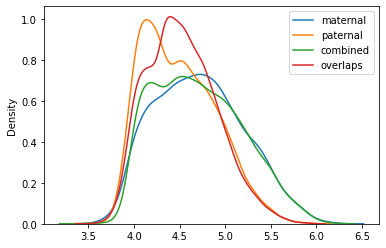

In [79]:
for parent, df in domains_2cell_k27.items():
    
    X = np.log10( (df['end'] - df['start']) )
    sns.kdeplot(X, label=parent)
    
plt.legend()

__Determine with which bin clusters the domains overlap__

In [80]:
CLUSTER_BINSIZE = 100000

In [81]:
domains_overlap_with_cluster = dict()

for domainset, df in domains_2cell_k27.items():
    print(domainset)
    df = df.copy()
    df = df[df.chrom.isin(bin_clusters['chrom'])].reset_index(drop=True)

    clusters = np.sort(bin_clusters['Kcluster'].unique())
    for k in clusters:
        df[k] = 0

    for irow, row in tqdm(df.iterrows(), total=len(df)):

        spanning_bins = np.arange(int(row['start']//CLUSTER_BINSIZE), int(np.ceil(row['end']//CLUSTER_BINSIZE))+1)

        ind = (bin_clusters.chrom == row['chrom']) & bin_clusters.bin_ind.isin(spanning_bins)
        k_overlap = bin_clusters.loc[ind,'Kcluster'].values

        # determine whether the whole domain falls in one cluster
        is_pure = (len(np.unique(k_overlap)) == 1)
        df.loc[irow, 'pure'] = is_pure

        if not is_pure:
            # determine how many of each
            for i, k in enumerate(k_overlap):

                if i == 0:
                    f = (BINSIZE - (row['start'] % BINSIZE)) / BINSIZE
                    df.loc[irow, k] += f
                elif i == (len(k_overlap) - 1):
                    f = (row['start'] % BINSIZE) / BINSIZE
                    df.loc[irow, k] += f
                else:
                    df.loc[irow, k] += 1

            T = (row['end'] - row['start']) / BINSIZE
            df.loc[irow, clusters] = df.loc[irow, clusters] / T

        else:
            df.loc[irow, k] = 1
            
    # determine which cluster shows the biggest overlap per domain
    df['max_frac'] = df[clusters].max(axis=1)
    print(domainset, (df.max_frac == 0).mean(), (df.max_frac > 0.75).mean())
    df = df[df.max_frac > .75]
    
    for irow, row in df.iterrows():
        i = np.argmax([row[k] for k in clusters])
        k = clusters[i]
        df.loc[irow, 'matching_K'] = k
    
    df['matching_K'] = df['matching_K'].astype(int)
    
    domains_overlap_with_cluster[domainset] = df

maternal


  0%|          | 0/6494 [00:00<?, ?it/s]

maternal 0.02740991684631968 0.7593162919618109
paternal


  0%|          | 0/9175 [00:00<?, ?it/s]

paternal 0.02986376021798365 0.8773841961852861
combined


  0%|          | 0/5339 [00:00<?, ?it/s]

combined 0.06574264843603671 0.7662483611163139
overlaps


  0%|          | 0/16928 [00:00<?, ?it/s]

overlaps 0.028178166351606804 0.8612948960302458


In [41]:
# bin_clusters_dict = dict()

# for chrom in chrom_order[:-2]:
    
#     ind = bin_clusters.loc[bin_clusters.chrom==chrom,'bin_ind'].values
#     k = bin_clusters.loc[bin_clusters.chrom==chrom,'Kcluster'].values
    
#     v = np.zeros(ind.max()+1)
#     v[:] = np.nan
#     v[ind] = k
#     assert CLUSTER_BINSIZE % BINSIZE == 0
#     v = np.repeat(v, int(CLUSTER_BINSIZE/BINSIZE))
#     v = v[:len(mapab[chrom])]
    
#     v2 = np.zeros(len(mapab[chrom]))
#     v2[:] = np.nan
#     v2[:len(v)] = v
    
#     bin_clusters_dict[chrom] = v2
    
#     print(v2.shape, len(mapab[chrom]))


# 5. Compute region matrices of H3K27me3 domains

## 5.1 Compute region matrices

In [42]:
sys.path.append('/Users/f.rang/surfdrive/Kind/data/scripts/')
import fakeTools_v3 as ft

### H3K27me3 domains

In [43]:
region_matrices = dict()

B = 250000
A = 250000
S = 250000

for parent in ['maternal', 'paternal', 'combined', 'overlaps']:
    
    domains = domains_2cell_k27[parent].copy()
    
    if parent == 'overlaps':
        
        for name, df in domains.groupby('parent'):
            name = 'overlaps_%s' % name
            region_matrices[(name, 'scaled')] = ft.computeMatrix_scaleregions(
                df[['chrom', 'start', 'end']], 
                before=B, after=A, scale=S, binsize=BINSIZE, N=100
            )
            
            region_matrices[(name, 'center')] = ft.computeMatrix_referencepoint(
                df[['chrom', 'start', 'end']], refpoint='center', 
                before=B, after=A, binsize=BINSIZE, N=200
            )
    
    else:
        region_matrices[(parent, 'scaled')] = ft.computeMatrix_scaleregions(
            domains, before=B, after=A, scale=S, binsize=BINSIZE, N=100
        )
        
        region_matrices[(parent, 'center')] = ft.computeMatrix_referencepoint(
            domains, refpoint='center', before=B, after=A, binsize=BINSIZE, N=200
        )

### H3K27me3 domains - split by cluster

In [44]:
for parent in ['maternal', 'paternal']:
    
    domains_per_cluster = domains_overlap_with_cluster[parent].copy()
    
    for k, df in domains_per_cluster.groupby('matching_K'):
        df = df.copy()[['chrom', 'start', 'end']]
        
        region_matrices[(parent, 'k=%d' % k, 'scaled')] = ft.computeMatrix_scaleregions(
            df, before=B, after=A, scale=S, binsize=BINSIZE, N=100
        )
        
        region_matrices[(parent, 'k=%d' % k, 'center')] = ft.computeMatrix_referencepoint(
            df, refpoint='center', before=B, after=A, binsize=BINSIZE, N=200
        )

### PADs

In [92]:
region_matrices[('PADs', 'scaled')] = ft.computeMatrix_scaleregions(
    pads, before=B, after=A, scale=S, binsize=BINSIZE, N=100
)

region_matrices[('PADs_merged', 'scaled')] = ft.computeMatrix_scaleregions(
    pads_merged, before=B, after=A, scale=S, binsize=BINSIZE, N=100
)

# 6. External data over H3K27me3 domains

## 6.1 Function to plot external data over H3K27me3 domains

In [93]:
domainset = ('maternal', 'scaled')
ext_sample = 'GSE76687_008'
rmatrix = region_matrices[domainset]

def plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='default'):
    domainset = (domain_parent, domain_type)
    rmatrix = region_matrices[domainset]
    
    # set-up figure layout
    fig, axes = plt.subplots(2, 2, figsize=(6, 8), gridspec_kw={'height_ratios': [1,5]})
    plt.subplots_adjust(hspace=0, wspace=.4)

    # determine ordering of domains
    if (sort_sample == 'separate') or (sort_sample not in ext_data[sort_allele]):
        print('Sorting regions independently')
        sort_sample = 'separate'
    else:
        D = ext_data[sort_allele][sort_sample]
        M = ft.computeSampleMatrix(D, rmatrix)
        sort_ind = np.argsort(M.mean(axis=1))
        
        sort_stage = ext_anno.loc[ext_anno.sample_id==sort_sample,'stage'].values[0]
        sort_target = ext_anno.loc[ext_anno.sample_id==sort_sample,'target'].values[0]
    
    # compute sample matrix and determine color range
    M_alleles = dict()
    D_alleles = dict()
    crange = list()
    for parent in ['maternal', 'paternal']:
        

        # determine whether there is a control, if so normalize
        control = ext_anno.loc[ext_anno.sample_id==ext_sample,'control_id'].values[0]
        if control != 'none':
            ctrl = ext_data[parent][control]
            samp = ext_data[parent][ext_sample]
            d = {c: np.log2( (samp[c] + .1) / (ctrl[c] + .1) ) for c in chrom_order}
        elif ext_sample in ext_data['allele_vis']:         
            d = ext_data[parent + '_corrected'][ext_sample]
            
        D_alleles[parent] = d
        
        # compute data for heatmap
        m = ft.computeSampleMatrix(d, rmatrix)
        
        if sort_sample == 'separate':
            sort_ind = np.argsort(m.mean(axis=1))
        
        m = m[sort_ind,:]
        
        M_alleles[parent] = m
        
        crange.append(np.percentile(m, [2,98]))
    crange = np.array(crange)
    
    if control != 'none':
        vmax = abs(crange).max().max()
        crange = np.array([-vmax, vmax])
        cmap = 'coolwarm' if cmap == 'default' else cmap
    else:
        crange = np.array([crange.min(axis=0)[0], crange.max(axis=0)[1]])
        cmap = 'bone_r' if cmap == 'default' else cmap

    # iterate over alleles of sample and plot enrichment over domains
    for icol, parent in enumerate(['maternal', 'paternal']):
        
        # select data
        D = D_alleles[parent]
        M = M_alleles[parent]

        # mask bins blacklisted by ENCODE or with low allele separation
        if ext_sample in ext_data['allele_vis']:
            filt_ind = {c: ext_data['blacklisted'][c] & (ext_data['allele_vis'][ext_sample][c] < 0.1) for c in chrom_order}
        else:
            filt_ind = ext_data['blacklisted']
        
        Dmasked = {c: np.copy(D[c]) for c in chrom_order}
        for c in chrom_order:
            Dmasked[c][filt_ind[c]] = np.nan

        # compute data for average
        Mmasked = ft.computeSampleMatrix(Dmasked, rmatrix)
        Y = np.nanmean(Mmasked, axis=0)

        ax0 = axes[0, icol]
        ax1 = axes[1, icol]

        # plot average over domains
        ax0.plot(Y)
        ax0.set_xlim(0, len(Y))
        ax0.set_title(parent)
        ax0.set_xticks([])
        ax0.set_ylabel('avg. RPKM')

        p = ax1.imshow(
            M, aspect='auto', origin='lower', 
            cmap=cmap, vmin=crange[0], vmax=crange[1]
        )
        cbar = plt.colorbar(p, ax=ax1, orientation='horizontal')
        cbar.ax.set_xlabel('RPKM')

        ax1.set_yticks([])
        if sort_sample == 'separate':
            ax1.set_ylabel('independently sorted\nN = %d' % M.shape[0])
        else:
            ax1.set_ylabel('sorted by\n%s %s (%s) %s\nN = %d' % (sort_stage, sort_target, sort_sample, sort_allele, M.shape[0]))

        if domainset[1] == 'center':
            ax1.set_xticks([0, B/(B+A)*M.shape[1], M.shape[1]])
            ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '+%dkb' % (A/1000)])
        elif domainset[1] == 'scaled':
            ax1.set_xticks([0, B/(B+S+A)*M.shape[1], (B+S)/(B+S+A)*M.shape[1], M.shape[1]])
            ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '+%dkb' % (A/1000)])


    # ensure Y-range is the same for both parents on average profile
    yrange = np.array([ax.get_ylim() for ax in axes[0,:]])
    ymin = yrange.min(axis=0)[0]
    ymax = yrange.max(axis=0)[1]
    for ax in axes[0,:]:
        ax.set_ylim(ymin, ymax)

    stage = ext_anno.loc[ext_anno.sample_id==ext_sample,'stage'].values[0]
    target = ext_anno.loc[ext_anno.sample_id==ext_sample,'target'].values[0]
    t = '%s %s (%s)\nenrichment over\nH3K27me3 domains - %s - %s' % (stage, target, ext_sample, domain_parent, domain_type)
    plt.suptitle(t, fontsize=14, y=1)

## 6.2 2-cell H3K27me3 ChIP-seq over 2-cell H3K27me3 domains

__Over maternal 2-cell H3K27me3 domains__

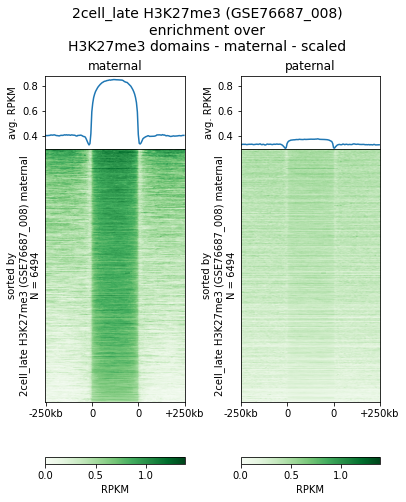

In [70]:
ext_sample = 'GSE76687_008'
domain_parent = 'maternal'
sort_sample = ext_sample
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='Greens')

outfn = FIGOUTDIR + 'ChIPseq_H3K27me3_2cell.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal 2-cell H3K27me3 domains__

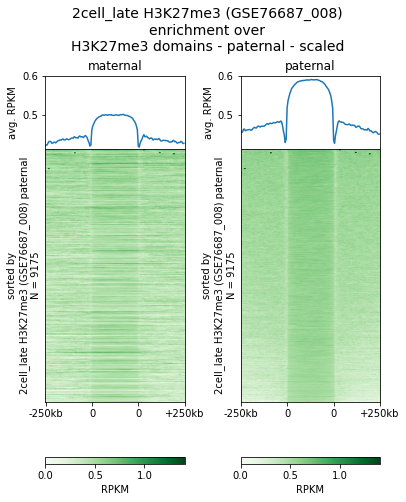

In [71]:
ext_sample = 'GSE76687_008'
domain_parent = 'paternal'
sort_sample = ext_sample
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='Greens')

outfn = FIGOUTDIR + 'ChIPseq_H3K27me3_2cell.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-SPECIFIC (no paternal) 2-cell H3K27me3 domains__

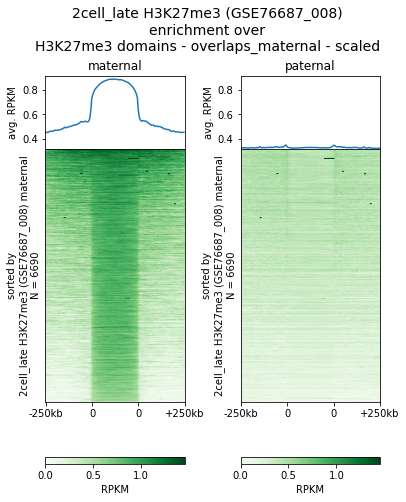

In [72]:
ext_sample = 'GSE76687_008'
domain_parent = 'overlaps_maternal'
sort_sample = ext_sample
sort_allele = 'maternal'

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='Greens')

outfn = FIGOUTDIR + 'ChIPseq_H3K27me3_2cell.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal-SPECIFIC (no maternal) 2-cell H3K27me3 domains__

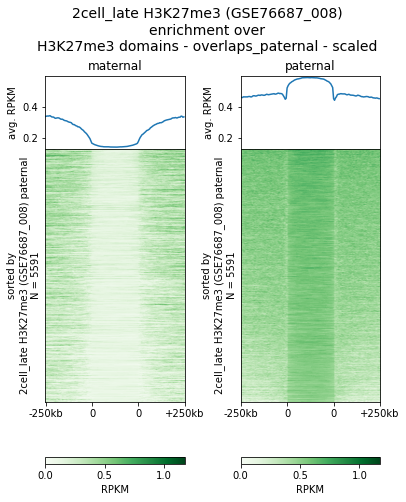

In [73]:
ext_sample = 'GSE76687_008'
domain_parent = 'overlaps_paternal'
sort_sample = ext_sample
sort_allele = 'paternal'

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='Greens')

outfn = FIGOUTDIR + 'ChIPseq_H3K27me3_2cell.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal COMMON 2-cell H3K27me3 domains__

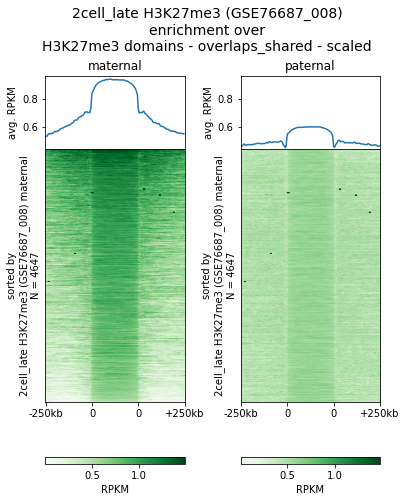

In [74]:
ext_sample = 'GSE76687_008'
domain_parent = 'overlaps_shared'
sort_sample = ext_sample 
sort_allele = 'maternal'

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled', cmap='Greens')

outfn = FIGOUTDIR + 'ChIPseq_H3K27me3_2cell.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

## 6.3 2-cell H3K9me3 ChIP-seq over 2-cell H3K27me3 domains

__Over maternal 2-cell H3K27me3 domains__

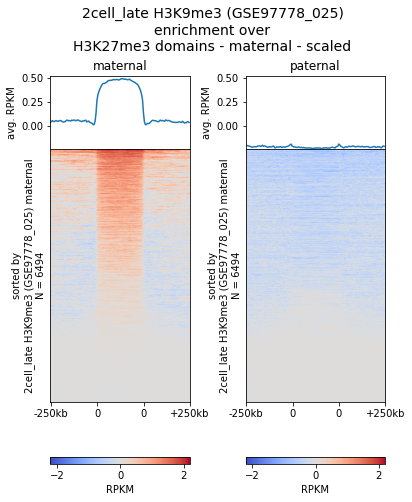

In [78]:
ext_sample = 'GSE97778_025'
domain_parent = 'maternal'
sort_sample = 'GSE97778_025'
sort_allele = 'maternal'

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

# sorted by H3K27me3
sort_sample = 'GSE76687_008'
plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_maternal_2cell_H3K27me3_domains.sorted_by_H3K27me3.pdf'
plt.savefig(outfn, bbox_inches='tight')
plt.close()

__Over paternal 2-cell H3K27me3 domains__

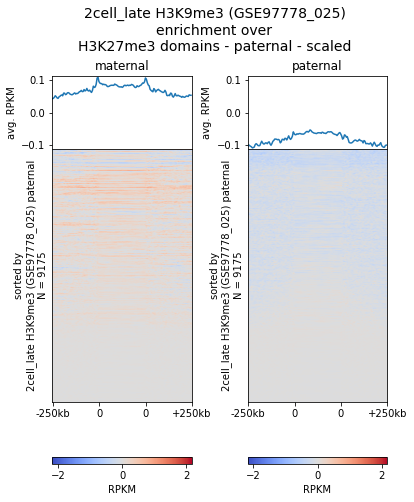

In [79]:
ext_sample = 'GSE97778_025'
domain_parent = 'paternal'
sort_sample = 'GSE97778_025'
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-SPECIFIC (no paternal) 2-cell H3K27me3 domains__

In [80]:
# ext_sample = 'GSE97778_025'
# domain_parent = 'overlaps_maternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over paternal-SPECIFIC (no maternal) 2-cell H3K27me3 domains__

In [81]:
# ext_sample = 'GSE97778_025'
# domain_parent = 'overlaps_paternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal COMMON 2-cell H3K27me3 domains__

In [82]:
# ext_sample = 'GSE97778_025'
# domain_parent = 'overlaps_shared'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K9me3_2cell.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

## 6.4 2-cell H2AK119ub1 ChIP-seq over 2-cell H3K27me3 domains

__Over maternal 2-cell H3K27me3 domains__

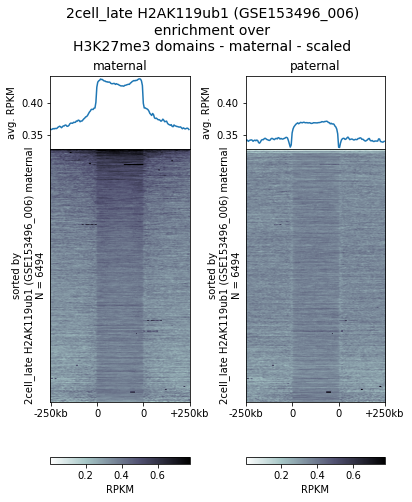

In [83]:
ext_sample = 'GSE153496_006'
domain_parent = 'maternal'
sort_sample = 'GSE153496_006'
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H2AK119ub1_2cell.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal 2-cell H3K27me3 domains__

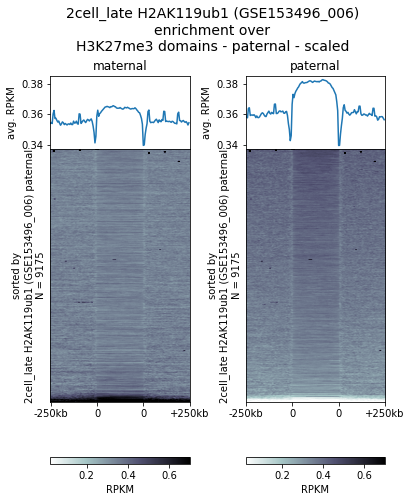

In [84]:
ext_sample = 'GSE153496_006'
domain_parent = 'paternal'
sort_sample = 'GSE153496_006'
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H2AK119ub1_2cell.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-SPECIFIC (no paternal) 2-cell H3K27me3 domains__

In [85]:
# ext_sample = 'GSE153496_006'
# domain_parent = 'overlaps_maternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H2AK119ub1_2cell.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over paternal-SPECIFIC (no maternal) 2-cell H3K27me3 domains__

In [86]:
# ext_sample = 'GSE153496_006'
# domain_parent = 'overlaps_paternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H2AK119ub1_2cell.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal COMMON 2-cell H3K27me3 domains__

In [87]:
# ext_sample = 'GSE153496_006'
# domain_parent = 'overlaps_shared'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H2AK119ub1_2cell.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

## 6.5 2-cell H3K4me3 ChIP-seq over 2-cell H3K27me3 domains

__Over maternal 2-cell H3K27me3 domains__

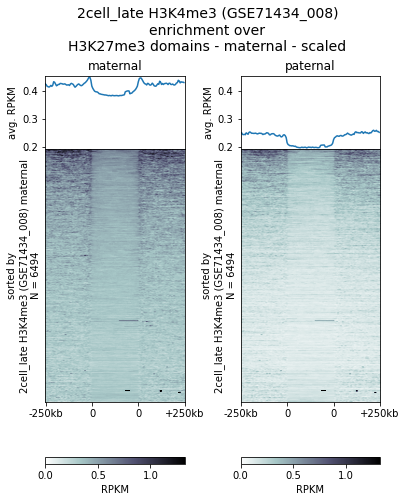

In [88]:
ext_sample = 'GSE71434_008'
domain_parent = 'maternal'
sort_sample = 'GSE71434_008'
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H3K4me3_2cell.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal 2-cell H3K27me3 domains__

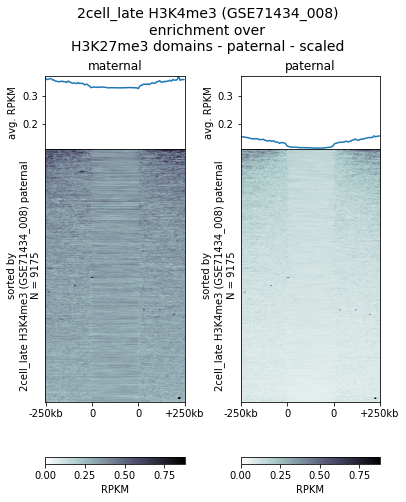

In [89]:
ext_sample = 'GSE71434_008'
domain_parent = 'paternal'
sort_sample = 'GSE71434_008'
sort_allele = domain_parent

plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

outfn = FIGOUTDIR + 'ChIPseq_H3K4me3_2cell.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-SPECIFIC (no paternal) 2-cell H3K27me3 domains__

In [90]:
# ext_sample = 'GSE71434_008'
# domain_parent = 'overlaps_maternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K4me3_2cell.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over paternal-SPECIFIC (no maternal) 2-cell H3K27me3 domains__

In [91]:
# ext_sample = 'GSE71434_008'
# domain_parent = 'overlaps_paternal'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K4me3_2cell.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal COMMON 2-cell H3K27me3 domains__

In [92]:
# ext_sample = 'GSE71434_008'
# domain_parent = 'overlaps_shared'
# sort_sample = 'separate'
# sort_allele = domain_parent

# plot_external_over_domains(ext_sample, domain_parent, sort_sample, sort_allele, domain_type='scaled')

# outfn = FIGOUTDIR + 'ChIPseq_H3K4me3_2cell.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

# 7. Lmnb1 enrichment over H3K27me3 domains

## 7.1 Function to plot Lmnb1 enrichment over H3K27me3 domains

In [96]:
from sklearn.cluster import KMeans

In [97]:
def generate_matrices(sample, allele, rmatrix):
    if sample in damid_insilico_logoe[allele]:
        D = damid_insilico_logoe[allele][sample]

        # mask bins that have low mappability or allele separation
        Dmasked = {c: np.copy(D[c]) for c in chrom_order}
        for c in chrom_order:
            Dmasked[c][mapab[c] <= MINMAP] = np.nan
            if allele != 'combined':
                Dmasked[c][~allele_filt_gt[sample[1]][c]] = np.nan
                
    elif sample in ext_data[allele]:
        ctrl = ext_anno.loc[ext_anno['sample_id']==sample,'control_id'].values[0]
        
        if allele == 'combined':
            D = ext_data[allele][sample]
        elif (sample in ext_data[allele + '_corrected']) and (ctrl == 'none'):
            D = ext_data[allele + '_corrected'][sample]
        else:
            D = ext_data[allele][sample]
            
        if ctrl != 'none':
            C = ext_data[allele][ctrl]
            D = {c: np.log2( (D[c] + .1) / (C[c] + .1) ) for c in chrom_order}

        # mask bins that are blacklisted or have poor allele separation
        Dmasked = {c: np.copy(D[c]) for c in chrom_order}
        for c in chrom_order:
            Dmasked[c][ext_data['blacklisted'][c]] = np.nan
            if (allele != 'combined') and (sample in ext_data['allele_vis']):
                f = ext_data['allele_vis'][sample][c] < 0.1
                Dmasked[c][f] = np.nan
    
#     elif sample in dam1_insilico_logoe[allele]:
    
    M = ft.computeSampleMatrix(D, rmatrix)
    Mmasked = ft.computeSampleMatrix(Dmasked, rmatrix)
    
    return M, Mmasked

In [183]:
import itertools

In [99]:
def define_order_kmeans_clusters(M, n_clusters):
    
    assert n_clusters > 1

    Mm = np.nanmean(M, axis=1)
    Mm[np.isnan(Mm)] = np.nanmin(Mm)
    Mbm = np.nanmean((M > 0), axis=1)
    Mbm[np.isnan(Mbm)] = np.nanmin(Mbm)

    # generate clusters
    np.random.seed(1)
    cluster_ind = KMeans(n_clusters=n_clusters).fit_predict(Mbm.reshape(-1, 1))
    cluster_names = np.sort(np.unique(cluster_ind))
    
    #reorder clusters form lowest to highest enrichment
    ## determine mean values per cluster
    mean_vals = list()
    for k in cluster_names:
        m = Mm[cluster_ind==k].mean()
        mean_vals.append(m)
    
    ## find order of clusters
    tmp = cluster_names[np.argsort(mean_vals)]
    rename_dict = {k: i for i, k in enumerate(tmp)}
    
    ## rename
    cluster_ind_reorder = np.zeros_like(cluster_ind)
    for k in cluster_names:
        cluster_ind_reorder[cluster_ind == k] = rename_dict[k]
    cluster_ind = cluster_ind_reorder
    
    # find order of all domains
    tmp = np.array(list(zip(Mm,cluster_ind)))
    sort_ind = np.lexsort(tmp.T)
    cluster_ind = cluster_ind[sort_ind]

    return sort_ind, cluster_ind, cluster_names

In [111]:
def plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, n_clusters=1, vrange=[-1,1], sharey=False, ext_to_plot='default'):
    rmatrix = region_matrices[domainset]
    
    # Choose DamID samples to plot
    to_plot = anno_comb[anno_comb.is_singlecell].copy()
    
    # Choose External samples to plot
    if ext_to_plot == 'default':
        ext_to_plot = ext_anno[ext_anno.sample_id.isin(['GSE76687_008','GSE97778_025'])].copy()

    wr1 = np.concatenate([[1,2] if row['is_heterozygous'] else [1] for _, row in ext_to_plot.iterrows()])
    wr2 = np.concatenate([[1,2] if row['is_heterozygous'] else [1] for _, row in to_plot.iterrows()])
    wr = np.concatenate([wr1, wr2])
    ncol = len(wr)
    nrow = 2
    fig, axes = plt.subplots(
        nrow, ncol, figsize=(2.5*sum(wr), 8), 
        gridspec_kw={'height_ratios': [1,5], 'width_ratios': wr}
    )
    plt.subplots_adjust(hspace=0, wspace=.5)
    counter = 0

    # determine sorting based on provided sort sample
    if sort_sample:
        _, Mmasked = generate_matrices(sort_sample, sort_allele, rmatrix)
        if n_clusters > 1:
            sort_ind, cluster_ind, cluster_names = define_order_kmeans_clusters(Mmasked, n_clusters)
            cluster_sizes = np.array([(cluster_ind==k).sum() for k in cluster_names])
            cluster_seps = np.cumsum(cluster_sizes)[:-1]
            cluster_yticks = np.cumsum(cluster_sizes) - (cluster_sizes)/2
            cluster_yticklabs = ['k=%d\n(n=%d)' % (k, n) for k, n in zip(cluster_names, cluster_sizes)]
            cluster_colors = {k: sns.color_palette('tab10',n_colors=10)[i] for i, k in enumerate(cluster_names)}
            print(cluster_names, cluster_sizes, cluster_seps)
        else:
            Mm = np.nanmean(Mmasked, axis=1)
            sort_ind = np.argsort(Mm)


    
    
    ## PLOT ##
    all_rows = list(ext_to_plot.iterrows()) + list(to_plot.iterrows())
    for _, row in all_rows:
        
        is_external = ('sample_id' in row)
        if is_external:
            sample = row['sample_id']
        else:
            sample = (row['stage'], row['genotype'], row['treatment'])
        parents = ['combined', 'maternal', 'paternal'] if row['is_heterozygous'] else ['combined']

        for parent in parents:
            
            if parent in ['combined', 'maternal']:
                ax0 = axes[0, counter]
                ax1 = axes[1, counter]
                counter += 1

                relx = 0

            # select data
            M, Mmasked = generate_matrices(sample, parent, rmatrix)

            Y = np.nanmean(Mmasked, axis=0)
            X = np.arange(len(Y)) + relx
            relx = X.max() + 1

            # apply sorting
            if not sort_sample:
                sort_ind = np.argsort(np.nanmean(Mmasked, axis=1))
            Mmasked = Mmasked[sort_ind,:]
            M = M[sort_ind,:]

            # plot average
            if n_clusters > 1:
                for k in cluster_names:
                    Y = np.nanmean(Mmasked[cluster_ind==k,:], axis=0)
                    ax0.plot(X, Y, label='k=%d' % k, c=cluster_colors[k])
            else:
                ax0.plot(X, Y, c=color_dict['allele'][parent])
            x = {'combined': .5, 'maternal': .25, 'paternal': .75}[parent]
            ax0.text(x, 0.98, parent, transform=ax0.transAxes, va='top', ha='center')

            # determine suitable colormap
            if is_external:
                if row['control_id'] != 'none':
                    vmin, vmax = (-2, 2)
                    cmap = 'PuOr_r' if row['target'] == 'H3K9me3' else 'RdBu_r'
                    clrbarlab = 'log2OE'
                else:
                    vmin, vmax = (0, 1.2)
                    cmap = 'Greens' if row['target'] == 'H3K27me3' else 'bone_r'
                    clrbarlab = 'RPKM'

            else:
                vmin, vmax = vrange
                cmap = 'coolwarm'
                clrbarlab = 'log2OE'
            
            # plot heatmap
            p = ax1.imshow(
                M, extent=[X.min(), X.max(), 0, M.shape[0]],
                cmap=cmap, vmin=vmin, vmax=vmax,
                aspect='auto', origin='lower'
            )
            
            if parent in ['combined', 'paternal']:

                # plot color bar
                shr = 0.5 if parent == 'paternal' else 1
                cbar = plt.colorbar(p, ax=ax1, orientation='horizontal', shrink=shr)
                cbar.ax.set_xlabel(clrbarlab)

                # format
                if is_external:
                    tmp1 = ext_anno.loc[ext_anno.sample_id==sample,'stage'].values[0]
                    tmp2 = ext_anno.loc[ext_anno.sample_id==sample,'target'].values[0]
                    title = '%s - %s\n%s' % (tmp1, tmp2, sample)
                else:
                    title = '%s\n%s\n%s' % sample
                ax0.set_title(title)
                ax0.set_ylabel('avg. ' + clrbarlab)


                        
    ax0.legend(loc=(1,0))
    
    # format xlabels/ticks of heatmaps
    for i in np.arange(ncol):
        l = M.shape[1]
        is_allelic = (wr[i] == 2)
        
        ax1 = axes[1,i]
        ax0 = axes[0,i]
        
        # set allele sep
        if is_allelic:
            ax0.axvline(l, c='k')
            ax1.axvline(l, c='k')
            ax0.set_xlim(0,l*2)
            ax1.set_xlim(0,l*2)
        else:
            ax0.set_xlim(0,l)
            ax1.set_xlim(0,l)
        
        # set xticks
        ax0.set_xticks([])
        if domainset[-1] == 'center':
            if is_allelic:
                xticks = [0, B/(B+A)*l, l, (B)/(B+A)*l + l, 2*l]
                ax1.set_xticks(xticks)
                ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '', '0', '+%dkb' % (A/1000)])
            else:
                xticks = [0, B/(B+A)*l, l]
                ax1.set_xticks(xticks)
                ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '+%dkb' % (A/1000)])
        elif domainset[-1] == 'scaled':
            if is_allelic:
                xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l, B/(B+S+A)*l + l, (B+S)/(B+S+A)*l + l, 2*l]
                ax1.set_xticks(xticks)
                ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '', '0', '0', '+%dkb' % (A/1000)])
            else:
                xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l]
                ax1.set_xticks(xticks)
                ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '+%dkb' % (A/1000)])

    # format ylabels/ticks of heatmaps
    for ax1 in axes[1,:]:
        if n_clusters > 1:
            ax1.set_yticks(cluster_yticks)
            ax1.set_yticklabels(cluster_yticklabs)
            for y in cluster_seps:
                ax1.axhline(y, c='k')
        else:
            ax1.set_yticks([])
            ax1.set_ylabel('N = %d' % (M.shape[0]))

    # set same y-scale if requested
    if sharey: 
        axset = axes[0,len(wr1):]
        yrange = np.array([ax.get_ylim() for ax in axset])
        ymin = yrange.min(axis=0)[0]
        ymax = yrange.max(axis=0)[1]
        yd = (ymax - ymin) * .1
        ymin -= yd
        ymax += yd
        for ax in axset:
            ax.set_ylim(ymin, ymax)

    # set title
    if len(domainset) == 2:
        t = '%s H3K27me3 domains - %s' % domainset
    else:
        t = '%s H3K27me3 domains in %s - %s' % domainset
    if sort_sample:
        if sort_sample[0] in stage_order:
            t2 = '\nsorted by: %s - %s - %s - ' % sort_sample
        else:
            sort_stage = ext_anno.loc[ext_anno.sample_id==sort_sample,'stage'].values[0]
            sort_target = ext_anno.loc[ext_anno.sample_id==sort_sample,'target'].values[0]
            t2 = '\nsorted by: %s - %s (%s)' % (sort_stage, sort_target, sort_sample)
        t3 = '%s allele' % sort_allele
        t = t + t2 + t3
    else:
        t = t + '\n regions independently sorted (per sample and per allele)'

    plt.suptitle(t, fontsize=14, y=1.1)

## 7.2 Allele-specific Lmnb1 signal

__Over PADs__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/2752139094.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


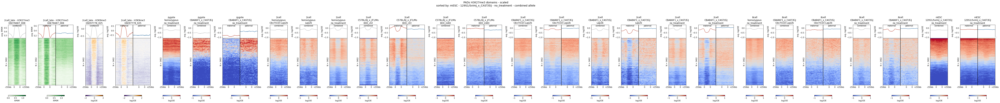

In [109]:
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
domainset = ('PADs', 'scaled')

plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, vrange=[-1,1], sharey=True)

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_PADs.pdf'
plt.savefig(outfn, bbox_inches='tight')

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/2752139094.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


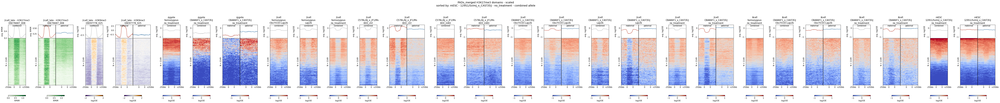

In [110]:
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
domainset = ('PADs_merged', 'scaled')

plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, vrange=[-1,1], sharey=True)

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_PADs_merged_100kb.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal H3K27me3 domains__

In [252]:
plot_settings = {
    'sorted_by_Lmnb1_mESC_untreated': [('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment'), 'combined'],
    'sorted_by_Lmnb1_2cell_untreated': [('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 'maternal'],
    'sorted_by_H3K27me3_2cell': ['GSE76687_008', 'maternal'],
    'sprted_by_H3K9me3_2cell': ['GSE97778_025', 'combined']
    
}

sorted_by_Lmnb1_mESC_untreated


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


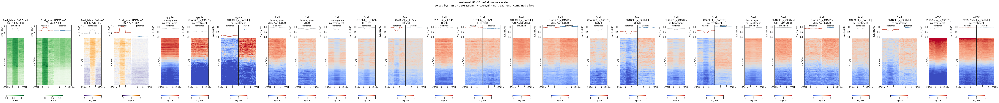

sorted_by_Lmnb1_2cell_untreated


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


sorted_by_H3K27me3_2cell


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


sprted_by_H3K9me3_2cell


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [253]:
for sortname in plot_settings.keys():
    print(sortname)
    sort_sample, sort_allele = plot_settings[sortname]
    
    domainset = ('maternal', 'scaled')
    plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, vrange=[-1,1])
    
    outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_maternal_2cell_H3K27me3_domains.%s.pdf' % sortname
    plt.savefig(outfn, bbox_inches='tight')
    
    if sortname == 'sorted_by_Lmnb1_mESC_untreated':
        plt.show()
    plt.close()


/Users/f.rang/.venvs/preimplantation/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[0 1] [3023 3471] [3023]


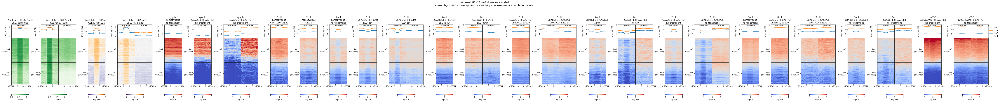

In [254]:
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
domainset = ('maternal', 'scaled')

plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, n_clusters=2, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_maternal_2cell_H3K27me3_domains.clustered_on_Lmnb1_mESC_untreated.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains__

In [255]:
plot_settings = {
    'sorted_by_Lmnb1_mESC_untreated': [('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment'), 'combined'],
    'sorted_by_Lmnb1_2cell_untreated': [('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 'paternal'],
    'sorted_by_H3K27me3_2cell': ['GSE76687_008', 'paternal'],
    'sprted_by_H3K9me3_2cell': ['GSE97778_025', 'combined']
    
}

sorted_by_Lmnb1_mESC_untreated


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


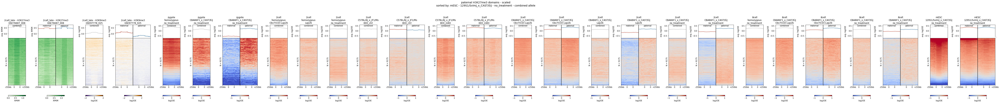

sorted_by_Lmnb1_2cell_untreated


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


sorted_by_H3K27me3_2cell


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


sprted_by_H3K9me3_2cell


/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_19884/744261296.py:34: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(Mmasked, axis=1)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


In [256]:
for sortname in plot_settings.keys():
    print(sortname)
    sort_sample, sort_allele = plot_settings[sortname]
    domainset = ('paternal', 'scaled')
    
    plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, vrange=[-1,1])
    
    outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_paternal_2cell_H3K27me3_domains.%s.pdf' % sortname
    plt.savefig(outfn, bbox_inches='tight')
    
    if sortname == 'sorted_by_Lmnb1_mESC_untreated':
        plt.show()
    plt.close()


/Users/f.rang/.venvs/preimplantation/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


[0 1] [1646 7529] [1646]


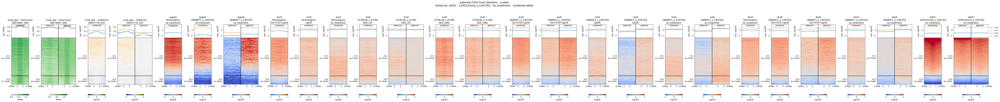

In [257]:
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
domainset = ('paternal', 'scaled')

plot_lmnb1_over_domains(domainset, sort_sample, sort_allele, n_clusters=2, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_paternal_2cell_H3K27me3_domains.clustered_on_Lmnb1_mESC_untreated.pdf'
plt.savefig(outfn, bbox_inches='tight')

## 7.3 Function to plot multiple sample Lmnb1 enrichment over H3K27me3 domains

In [120]:
def plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='treatment', vrange=[-1,1]):
    rmatrix = region_matrices[domainset]
#     to_plot = anno_comb[anno_comb.is_singlecell & anno_comb.is_heterozygous].copy()
#     to_plot = to_plot[(to_plot.genotype == 'C57BL/6J_x_JF1/Ms')]

    # sort rows same for all
    D = damid_insilico_logoe[sort_allele][sort_sample]
    Dmasked = {c: np.copy(D[c]) for c in chrom_order}
    for c in chrom_order:
        Dmasked[c][mapab[c] <= MINMAP] = np.nan
        if sort_allele != 'combined':
            Dmasked[c][~allele_filt_gt[sort_sample[1]][c]] = np.nan

    M = ft.computeSampleMatrix(Dmasked, rmatrix)
    Mm = np.nanmean(M, axis=1)
    Mm[np.isnan(Mm)] = -np.inf
    sort_ind = np.argsort(Mm)

    # set-up figure layout
    ncol = 2
    wr = [1,2]
    nrow = len(samples) + 2
    hr = [2] + [4]*len(samples) + [.2]
    figh = sum(hr)*1.2
    fig, axes = plt.subplots(nrow, ncol, figsize=(8, figh), gridspec_kw={'height_ratios': hr, 'width_ratios': wr})
    plt.subplots_adjust(hspace=0.4, wspace=0.4)
    irow = 0
    
    ax0 = axes[0]

    for isample, sample in enumerate(samples):

        irow += 1
        relx = 0

        for parent in ['maternal', 'paternal', 'combined']:
            
            ax0 = axes[0,0] if parent == 'combined' else axes[0,1]
            ax1 = axes[irow,0] if parent == 'combined' else axes[irow,1]
            axcbar = axes[-1,0] if parent == 'combined' else axes[-1,1]

            # select data
            if sample not in damid_insilico_logoe[parent]:
                continue
            D = damid_insilico_logoe[parent][sample].copy()
            M = ft.computeSampleMatrix(D, rmatrix)

            # mask bins that have low mappability or allele separation
            Dmasked = {c: np.copy(D[c]) for c in chrom_order}
            for c in chrom_order:
                Dmasked[c][mapab[c] <= MINMAP] = np.nan
                if parent != 'combined':
                    Dmasked[c][~allele_filt_gt[sample[1]][c]] = np.nan
                    D[c][~allele_filt_gt[sample[1]][c]] = 0
            Mmasked = ft.computeSampleMatrix(Dmasked, rmatrix)

            Y = np.nanmean(Mmasked, axis=0)
            if parent == 'combined':
                X = np.arange(len(Y))
            else:
                X = np.arange(len(Y)) + relx
                relx = X.max() + 1

            # determine sorting 
            if not sort_sample:
                sort_ind = np.argsort(M.mean(axis=1))
            M = M[sort_ind,:]

            # plot average enrichment
            if color_by == 'treatment':
                clr = color_dict['treatment'][sample[2]]
                lab = sample[2]
            elif color_by == 'stage':
                clr = color_dict['stage'][sample[0]]
                lab = sample[0]
            else:
                clr = sns.color_palette('tab10', n_colors=10)[isample]
                lab = sample
            ax0.plot(X, Y, c=clr, label=lab)
            x = 0.48 if parent == 'maternal' else 0.98
            ax0.text(x, 0.05, parent, transform=ax0.transAxes, va='bottom', ha='right')

            # plot heatmap
            p = ax1.imshow(
                M, extent=[X.min(), X.max(), 0, M.shape[0]],
                cmap='coolwarm', vmin=vrange[0], vmax=vrange[1],
                aspect='auto', origin='lower'
            )
            
            if parent == 'paternal':
                ax1.set_xlim(0, relx)
                ax1.axvline(relx/2, c='k')
            else:
                ax1.set_yticks([])
                ax1.set_ylabel('N = %d' % (M.shape[0]))
                ax1.set_title(lab)

            if irow == (len(samples)-1):
                cbar = plt.colorbar(p, cax=axcbar, orientation='horizontal', shrink=.5)
                cbar.ax.set_xlabel('log2OE')
            


        ax0.set_ylabel('avg. log2OE')
        
    # format xlabels for mat/pat allele plot
    for ax in axes[:-1,1]:
        ax0 = axes[0,1]
#         ax0.set_xticks([])
        ax0.axvline(relx/2, c='k')
        ax0.set_xlim(0, relx)
        
        l = M.shape[1]
        if domainset[-1] == 'center':
            xticks = [0, B/(B+A)*l, l, (B)/(B+A)*l + l, 2*l]
            ax.set_xticks(xticks)
            ax.set_xticklabels(['-%dkb' % (B/1000), '0', '', '0', '+%dkb' % (A/1000)])
        elif domainset[-1] == 'scaled':
            xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l, B/(B+S+A)*l + l, (B+S)/(B+S+A)*l + l, 2*l]
            ax.set_xticks(xticks)
            ax.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '', '0', '0', '+%dkb' % (A/1000)])
            
    # format xlabels for comb allele plot
    for ax in axes[:-1,0]:
        l = M.shape[1]
        ax0 = axes[0,0]
#         ax0.set_xticks([])
        ax0.set_xlim(0, l)

        if domainset[-1] == 'center':
            xticks = [0, B/(B+A)*l, l]
            ax.set_xticks(xticks)
            ax.set_xticklabels(['-%dkb' % (B/1000), '0', '+%dkb' % (A/1000)])
        elif domainset[-1] == 'scaled':
            xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l]
            ax.set_xticks(xticks)
            ax.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '+%dkb' % (A/1000)])
            

    # set title
    if len(domainset) == 2:
        t = '%s H3K27me3 domains - %s' % domainset
    else:
        t = '%s H3K27me3 domains in %s - %s' % domainset
    if sort_sample:
        t2 = '\nsorted by: %s - %s - %s - ' % sort_sample
        t3 = '%s allele' % sort_allele
        t = t + t2 + t3
    else:
        t = t + '\n regions independently sorted (per sample and per allele)'
    plt.suptitle(t, fontsize=14, y=.95)
    axes[0,1].legend(loc=(1.1,0))

## 7.4 EED mKO vs WT Lmnb1 enrichment over H3K27me3 domains

__Over maternal H3K27me3 domains__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


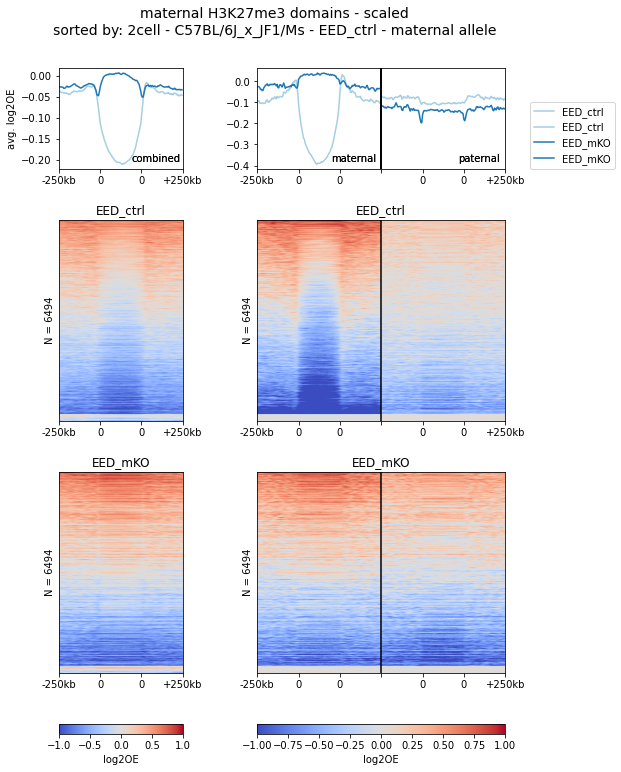

In [121]:
samples = [('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_ctrl'), ('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_mKO')]
domainset = ('maternal', 'scaled')
sort_sample = ('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_ctrl')
sort_allele = 'maternal'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_2cell_EEDmKO_vs_WT.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


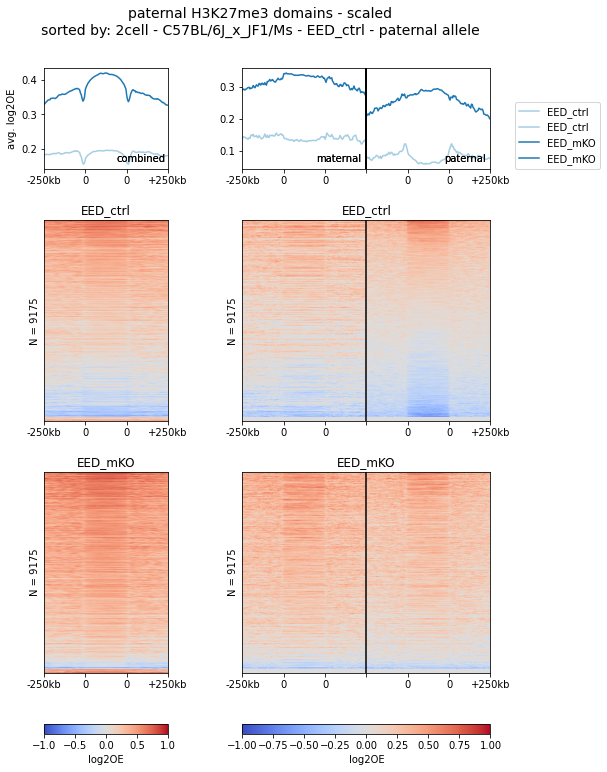

In [122]:
samples = [('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_ctrl'), ('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_mKO')]
domainset = ('paternal', 'scaled')
sort_sample = ('2cell', 'C57BL/6J_x_JF1/Ms', 'EED_ctrl')
sort_allele = 'paternal'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_2cell_EEDmKO_vs_WT.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

## 7.5 Cbx7-Lap2b vs untreated Lmnb1 enrichment over H3K27me3 domains

__Over maternal H3K27me3 domains__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


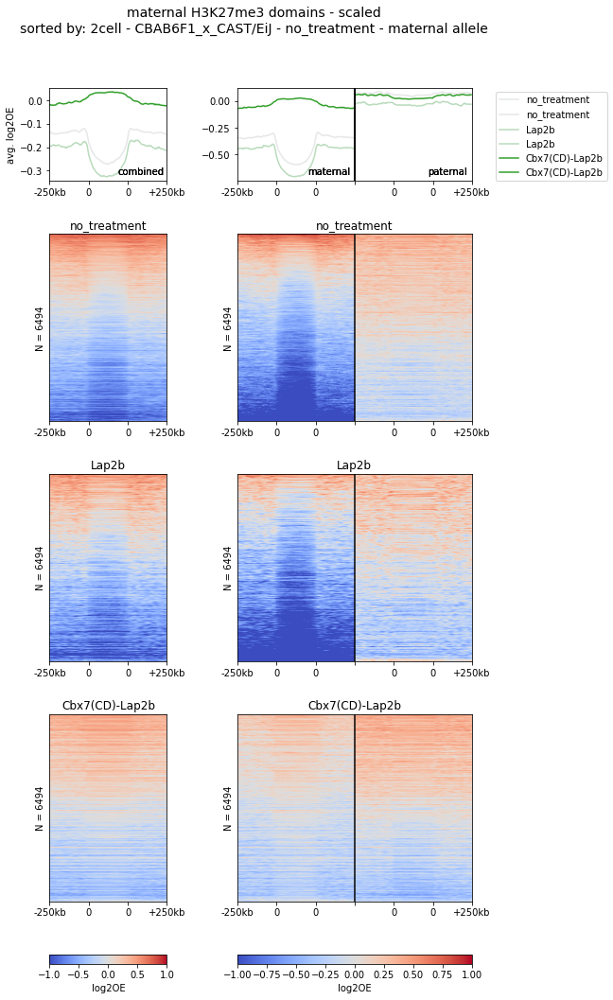

In [123]:
samples = [
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'Lap2b'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'Cbx7(CD)-Lap2b')
]
domainset = ('maternal', 'scaled')
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_2cell_Cbx7-Lap2b_vs_untreated.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


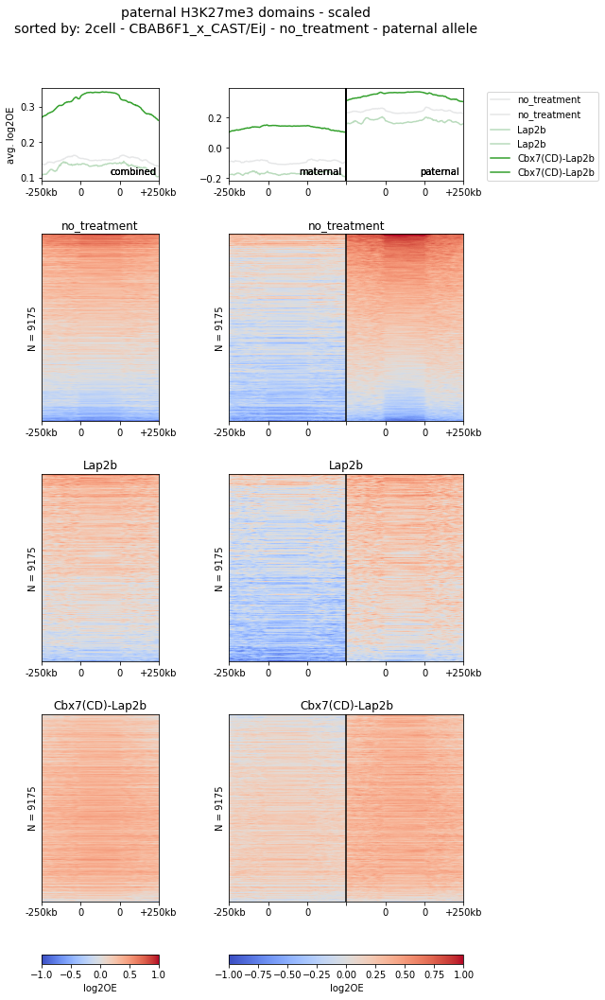

In [124]:
samples = [
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'Lap2b'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'Cbx7(CD)-Lap2b')
]
domainset = ('paternal', 'scaled')
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'paternal'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_2cell_Cbx7-Lap2b_vs_untreated.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

## 7.6 All untreated stages

__Over PADs__

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


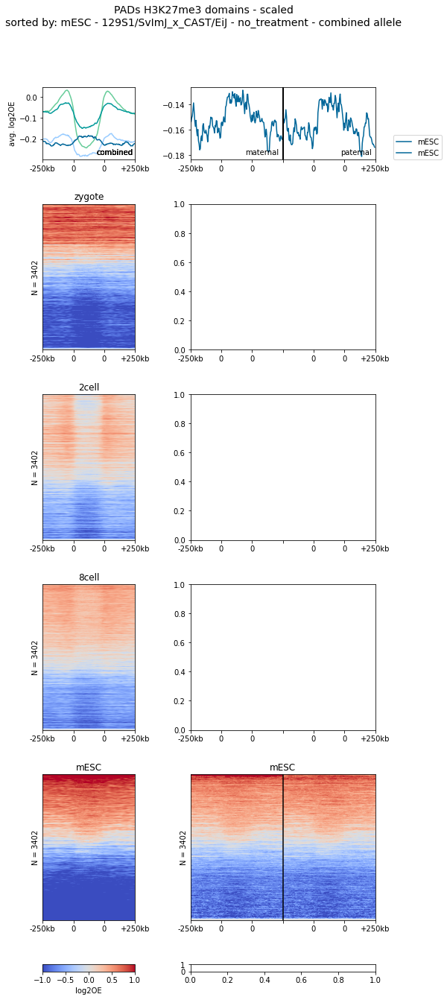

In [154]:
samples = [
    ('zygote', 'homozygous', 'no_treatment'), 
    ('2cell', 'homozygous', 'no_treatment'), 
    ('8cell', 'homozygous', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('PADs', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

# outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_PADs.pdf'
# plt.savefig(outfn, bbox_inches='tight')

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


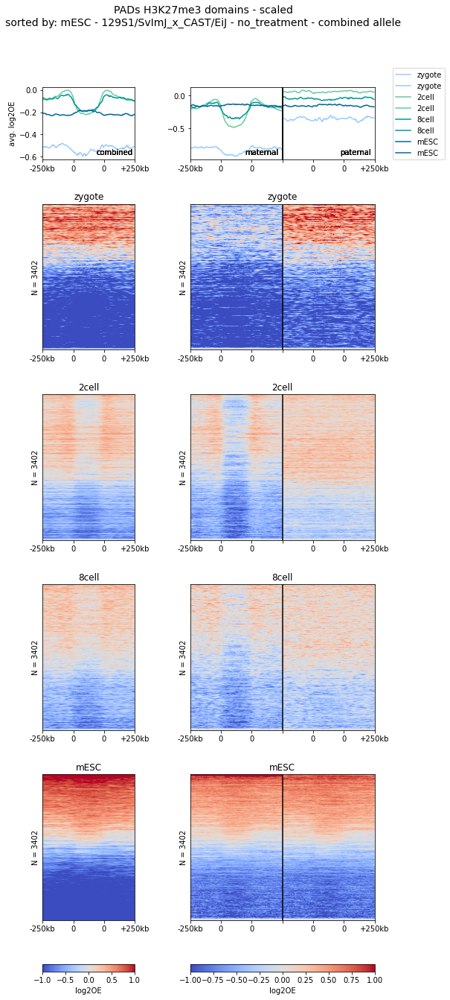

In [125]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('PADs', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_PADs.pdf'
plt.savefig(outfn, bbox_inches='tight')

/var/folders/f6/njqy731d5qzd2j0713w49f2jrtp6zr/T/ipykernel_70255/159064929.py:15: RuntimeWarning: Mean of empty slice
  Mm = np.nanmean(M, axis=1)


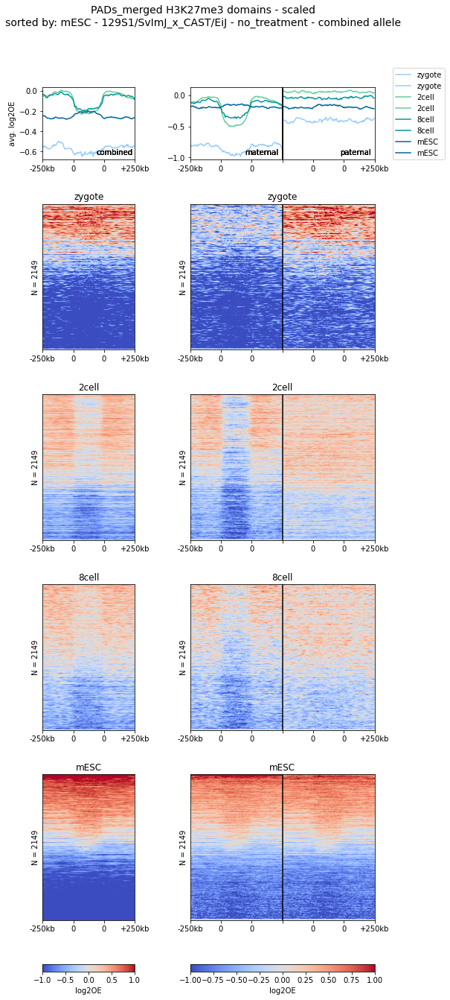

In [126]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('PADs_merged', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_PADs_100kb_merged.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal H3K27me3 domains__

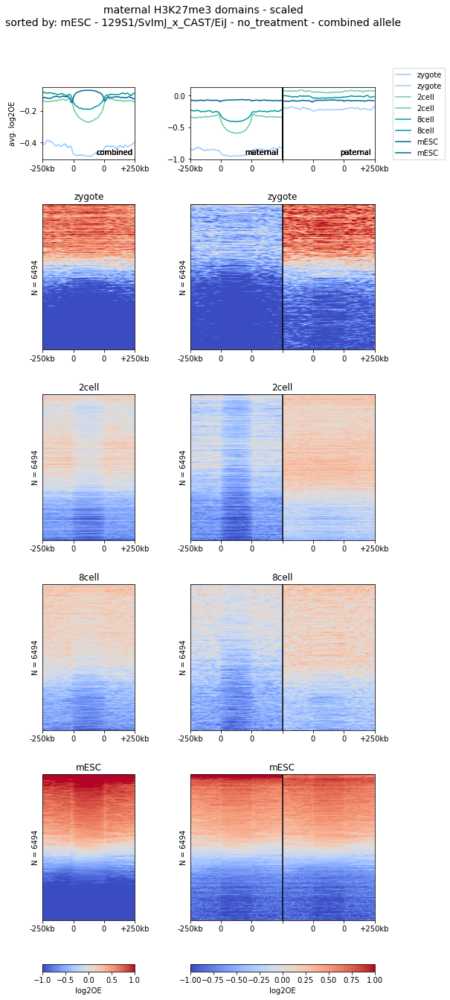

In [127]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('maternal', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains__

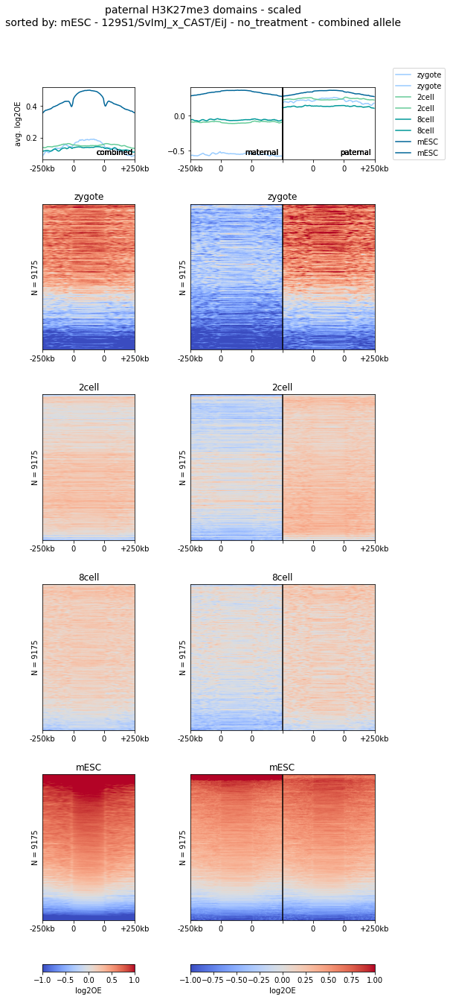

In [128]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('paternal', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal H3K27me3 domains, overlapping with k=2 (ET-iLADs)__

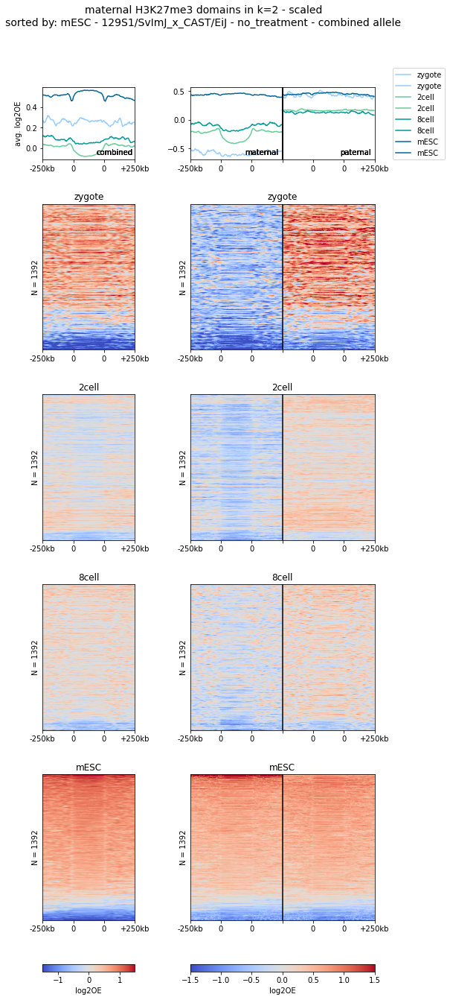

In [129]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('maternal', 'k=2', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1.5,1.5]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=vrange)

# outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_maternal_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains, overlapping with k=2 (ET-iLADs)__

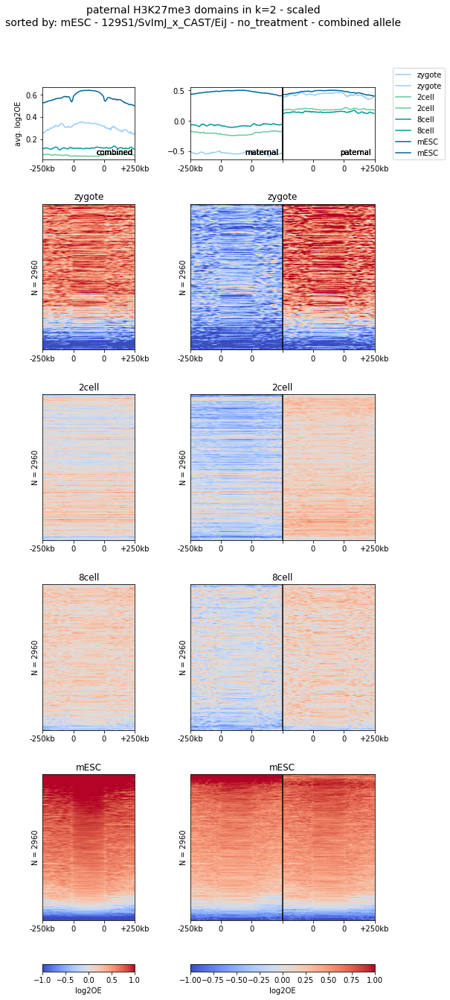

In [130]:
samples = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), 
    ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
domainset = ('paternal', 'k=2', 'scaled')
sort_sample = ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
sort_allele = 'combined'
vrange = [-1,1]

plot_lmnb1_multisample_over_domains(samples, domainset, sort_sample, sort_allele, color_by='stage', vrange=[-1,1])

# outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_paternal_2cell_H3K27me3_domains.pdf'
# plt.savefig(outfn, bbox_inches='tight')

## 7.7 Summary plot - interactions over PADs

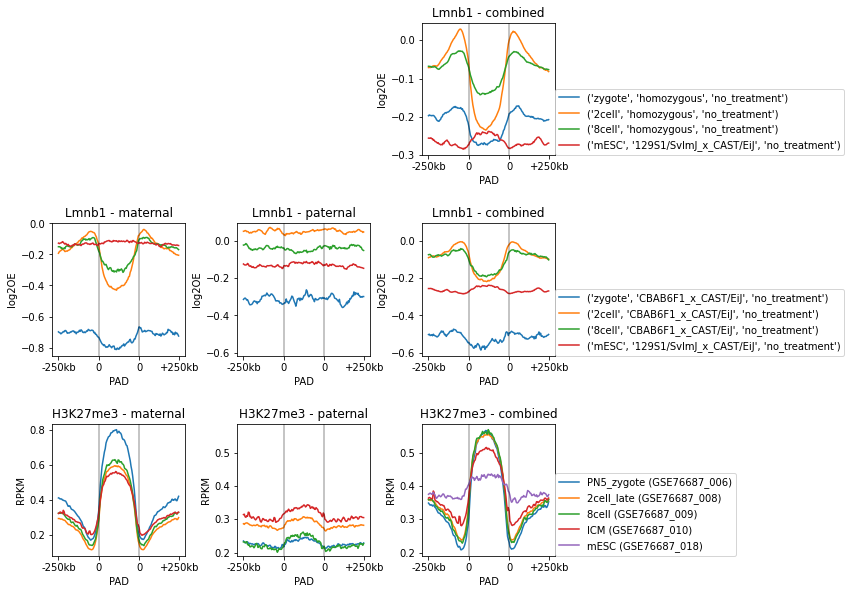

In [160]:
region = ('PADs', 'scaled')

sample_ls1 = [
    ('zygote', 'homozygous', 'no_treatment'), ('2cell', 'homozygous', 'no_treatment'),
    ('8cell', 'homozygous', 'no_treatment'), ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]

sample_ls2 = [
    ('zygote', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'),
    ('8cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment'), ('mESC', '129S1/SvImJ_x_CAST/EiJ', 'no_treatment')
]
ext_sample_ls = ['GSE76687_006', 'GSE76687_008', 'GSE76687_009', 'GSE76687_010', 'GSE76687_018']


fig, axes = plt.subplots(3,3,figsize=(9,10))
plt.subplots_adjust(hspace=.4, wspace=.4)

clrdict1 = {s: sns.color_palette('tab10',n_colors=10)[i] for i, s in enumerate(sample_ls1)}
clrdict2 = {s: sns.color_palette('tab10',n_colors=10)[i] for i, s in enumerate(sample_ls2)}
clrdict3 = {s: sns.color_palette('tab10',n_colors=10)[i] for i, s in enumerate(ext_sample_ls)}

for icol, allele in enumerate(['maternal', 'paternal', 'combined']):
    
    # plot DamID homozygous samples
    ax = axes[0,icol]
    if allele != 'combined':
        ax.remove()
    else:
        ax.set_title('Lmnb1 - %s' % allele)
        for condition in sample_ls1:
            M = ft.computeSampleMatrix(damid_insilico_logoe[allele][condition], region_matrices[region])
            Y = M.mean(axis=0)
            ax.plot(Y, label=condition, c=clrdict1[condition])
        ax.set_box_aspect(1)
        ax.set_ylabel('log2OE')
    
    # plot DamID - hybrid samples
    ax = axes[1,icol]
    ax.set_title('Lmnb1 - %s' % allele)
    for condition in sample_ls2:
        M = ft.computeSampleMatrix(damid_insilico_logoe[allele][condition], region_matrices[region])
        Y = M.mean(axis=0)
        ax.plot(Y, label=condition, c=clrdict2[condition])
    ax.set_box_aspect(1)
    ax.set_ylabel('log2OE')
        
    # plot H3K27me3
    ax = axes[2,icol]
    ax.set_title('H3K27me3 - %s' % allele)
    for sample in ext_sample_ls:
        a = 'combined' if allele == 'combined' else allele + '_corrected'
        if sample not in ext_data[a]:
            continue
        M = ft.computeSampleMatrix(ext_data[a][sample], region_matrices[region])
        Y = M.mean(axis=0)
        stage = ext_anno.set_index('sample_id').loc[sample,'stage']
        ax.plot(Y, label='%s (%s)' % (stage,sample), c=clrdict3[sample])
    ax.set_box_aspect(1)
    ax.set_ylabel('RPKM')
        
for i in range(1,3):
    yrange = np.array([ax.get_ylim() for ax in axes[i,1:]])
    ymin = yrange.min(axis=0)[0]
    ymax = yrange.max(axis=0)[1]
    for ax in axes[i,1:]:
        ax.set_ylim(ymin,ymax)
        
    axes[i,-1].legend(loc=(1,0))
axes[0,-1].legend(loc=(1,0))
    
for ax in [axes[0,2]] + list(axes[1:,:].flatten()):
    l = len(Y)
    ax.set_xticks([0,l/3,l*2/3,l])
    ax.set_xticklabels(['-250kb', '0', '0', '+250kb'])
    ax.axvline(l/3, c='k', alpha=.3)
    ax.axvline(l/3*2, c='k', alpha=.3)
    ax.set_xlabel('PAD')
    
    
outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages_in_one_plot.enrichment_over_PADs.summary_with_H3K27me3.pdf'
plt.savefig(outfn, bbox_inches='tight')

# 8. Borsos DamID1 Lmnb1 enrichment over H3K27me3 domains

## 8.1 Function to plot Lmnb1 enrichment over H3K27me3 domains

In [152]:
def plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-1,1], domain_type='scaled', use_smooth=True):
    domainset = (domain_allele, domain_type)
    rmatrix = region_matrices[domainset]
    to_plot = dam1_comb.copy()
    to_plot['is_heterozygous'] = to_plot['hybrid'] == 'yes'

    wr = np.concatenate([[1,2] if row['is_heterozygous'] else [1] for _, row in to_plot.iterrows()])
    ncol = len(to_plot) + to_plot.is_heterozygous.sum()
    assert len(wr) == ncol
    nrow = 2
    fig, axes = plt.subplots(
        nrow, ncol, figsize=(2.5*sum(wr), 8), 
        gridspec_kw={'height_ratios': [1,5], 'width_ratios': wr}
    )
    plt.subplots_adjust(hspace=0, wspace=.5)
    counter = 0

    # determine sorting based on provided sort sample - Assumed to be a Kind DamID2 sample
    if sort_sample:
        D = damid_insilico_logoe[sort_allele][sort_sample]
        
        # mask bins that have low mappability or allele separation
        Dmasked = {c: np.copy(D[c]) for c in chrom_order}
        for c in chrom_order:
            Dmasked[c][mapab[c] <= MINMAP] = np.nan
            if sort_allele != 'combined':
                Dmasked[c][~allele_filt_gt[sort_sample[1]][c]] = np.nan
        
        M = ft.computeSampleMatrix(Dmasked, rmatrix)
        Mm = np.nanmean(M, axis=1)
        Mm[np.isnan(Mm)] = -np.inf
        sort_ind = np.argsort(Mm)

    for _, row in to_plot.iterrows():
        
        parents = ['combined', 'maternal', 'paternal'] if row['is_heterozygous'] else ['combined']

        for parent in parents:
            
            if parent in ['combined', 'maternal']:
                ax0 = axes[0, counter]
                ax1 = axes[1, counter]
                counter += 1

                relx = 0

            # select data
            sample = row['sample']
            D = dam1_insilico_logoe[parent][sample] if use_smooth else dam1_insilico_logoe[parent][sample]
            M = ft.computeSampleMatrix(D, rmatrix)

            # mask bins that have low mappability or allele separation
            Dmasked = {c: np.copy(D[c]) for c in chrom_order}
            for c in chrom_order:
                Dmasked[c][mapab[c] <= MINMAP] = np.nan
                
                if row['is_heterozygous']:
                    Dmasked[c][~dam1_vis[sample][c]] = np.nan
            Mmasked = ft.computeSampleMatrix(Dmasked, rmatrix)

            Y = np.nanmean(Mmasked, axis=0)
            X = np.arange(len(Y)) + relx
            relx = X.max() + 1

            # determine sorting 
            if not sort_sample:
                sort_ind = np.argsort(M.mean(axis=1))
            M = M[sort_ind,:]

            # plot average
            ax0.plot(X, Y, c=color_dict['allele'][parent])
            x = {'combined': .5, 'maternal': .25, 'paternal': .75}[parent]
            ax0.text(x, 0.98, parent, transform=ax0.transAxes, va='top', ha='center')

            # plot heatmap
            p = ax1.imshow(
                M, extent=[X.min(), X.max(), 0, M.shape[0]],
                cmap='coolwarm', vmin=vrange[0], vmax=vrange[1],
                aspect='auto', origin='lower'
            )
            
            if parent in ['combined', 'paternal']:

                # plot color bar
                shr = 0.5 if parent == 'paternal' else 1
                cbar = plt.colorbar(p, ax=ax1, orientation='horizontal', shrink=shr)
                cbar.ax.set_xlabel('log2OE')

                # format
                ax1.set_yticks([])
                ax1.set_ylabel('N = %d' % (M.shape[0]))
                ax1.set_xlim(0, relx)
                if parent == 'paternal':
                    ax1.axvline(relx/2, c='k')
                    ax0.axvline(relx/2, c='k')

                ax0.set_xticks([])
                ax0.set_title(sample.replace(':', '\n'))
                ax0.set_xlim(0, relx)
                ax0.set_ylabel('avg. log2OE')

                # set xticks and labels
                l = M.shape[1]
                if domainset[1] == 'center':
                    if parent == 'paternal':
                        xticks = [0, B/(B+A)*l, l, (B)/(B+A)*l + l, 2*l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '', '0', '+%dkb' % (A/1000)])
                    else:
                        xticks = [0, B/(B+A)*l, l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '+%dkb' % (A/1000)])
                elif domainset[1] == 'scaled':
                    if parent == 'paternal':
                        xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l, B/(B+S+A)*l + l, (B+S)/(B+S+A)*l + l, 2*l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '', '0', '0', '+%dkb' % (A/1000)])
                    else:
                        xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '+%dkb' % (A/1000)])

    # set same y-scale if requested
    if sharey: 
        yrange = np.array([ax.get_ylim() for ax in axes[0,:]])
        ymin = yrange.min(axis=0)[0]
        ymax = yrange.max(axis=0)[1]
        yd = (ymax - ymin) * .1
        ymin -= yd
        ymax += yd
        for ax in axes[0,:]:
            ax.set_ylim(ymin, ymax)

    # set title
    t = 'H3K27me3 domains - %s - %s' % domainset
    if sort_sample:
        t2 = '\nsorted by: %s %s %s (Kind DamID2) ' % sort_sample
        t3 = '%s allele' % sort_allele
        t = t + t2 + t3
    else:
        t = t + '\n regions independently sorted (per sample and per allele)'

    plt.suptitle(t, fontsize=14, y=1.1)

## 8.2 Allele-specific Lmnb1 signal

__Over maternal H3K27me3 domains__

In [6]:
domain_allele = 'maternal'
domain_type = 'scaled'
sharey = True
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange = [-1,1]

plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-.7,.7], domain_type='scaled')

# outfn = FIGOUTDIR + 'Borsos_DamID1_Lmnb1_all_stages.enrichment_over_maternal_2cell_H3K27me3_domains.smooth_std_%d.pdf' % BORSOS_SMOOTH_STD
# plt.savefig(outfn, bbox_inches='tight')

__Over paternal H3K27me3 domains__

In [5]:
domain_allele = 'paternal'
domain_type = 'scaled'
sharey = True
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'paternal'
vrange = [-1,1]

plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-.9,.9], domain_type='scaled')

outfn = FIGOUTDIR + 'Borsos_DamID1_Lmnb1_all_stages.enrichment_over_paternal_2cell_H3K27me3_domains.smooth_std_%d.pdf' % BORSOS_SMOOTH_STD
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-specific (no paternal!) H3K27me3 domains__

In [4]:
domain_allele = 'overlaps_maternal'
domain_type = 'scaled'
sharey = True
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange = [-1,1]

plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-.7,.7], domain_type='scaled')

outfn = FIGOUTDIR + 'Borsos_DamID1_Lmnb1_all_stages.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.smooth_std_%d.pdf' % BORSOS_SMOOTH_STD
plt.savefig(outfn, bbox_inches='tight')

__Over paternal-specific (no maternal!) H3K27me3 domains__

In [3]:
domain_allele = 'overlaps_paternal'
domain_type = 'scaled'
sharey = True
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'paternal'
vrange = [-1,1]

plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-1,1], domain_type='scaled')

outfn = FIGOUTDIR + 'Borsos_DamID1_Lmnb1_all_stages.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.smooth_std_%d.pdf' % BORSOS_SMOOTH_STD
plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal COMMON H3K27me3 domains__

In [2]:
domain_allele = 'overlaps_shared'
domain_type = 'scaled'
sharey = True
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange = [-1,1]

plot_borsos_over_domains(domain_allele, sort_sample, sort_allele, vrange=[-.9,.9], domain_type='scaled')

outfn = FIGOUTDIR + 'Borsos_DamID1_Lmnb1_all_stages.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.smooth_std_%d.pdf' % BORSOS_SMOOTH_STD
plt.savefig(outfn, bbox_inches='tight')

# 9. Enrichment of Lmnb1 data over domains, split by bin cluster

## 9.1 Compute region matrices

In [81]:
region_matrices_per_k = dict()

B = 250000
A = 250000
S = 250000

for parent in ['maternal', 'paternal', 'combined', 'overlaps']:
    
    if parent != 'overlaps':
        region_matrices_per_k[parent] = dict()
    else:
        region_matrices_per_k['overlaps_maternal'] = dict()
        region_matrices_per_k['overlaps_paternal'] = dict()
        region_matrices_per_k['overlaps_shared'] = dict()
    
    for k in clusters:
    
        domains = domains_overlap_with_cluster[parent].copy()
        domains = domains[domains.matching_K == k]
        
        if len(domains) == 0:
            continue

        if parent == 'overlaps':

            for name, df in domains.groupby('parent'):
                
                if len(df) == 0:
                    continue
                
                name = 'overlaps_%s' % name
                region_matrices_per_k[name][k] = ft.computeMatrix_scaleregions(
                    df[['chrom', 'start', 'end']], 
                    before=B, after=A, scale=S, binsize=BINSIZE, N=100
                )

        else:
            region_matrices_per_k[parent][k] = ft.computeMatrix_scaleregions(
                domains[['chrom', 'start', 'end']], before=B, after=A, scale=S, binsize=BINSIZE, N=100
            )

## 9.2 Function to plot Lmnb1 enrichment over 2-cell H3K27me3 domains split by cluster

In [62]:
k_clr_dict = {k: sns.color_palette('tab10', n_colors=10)[i] for i, k in enumerate(clusters)}

In [63]:
def plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1]):

    to_plot = anno_comb[anno_comb.is_singlecell].copy()

    # select domains of interest
    if 'overlaps' not in domainset:
        domaindf = domains_overlap_with_cluster[domainset].copy()
    else:
        domaindf = domains_overlap_with_cluster['overlaps'].copy()
        p = domainset.split('_')[1]
        domaindf = domaindf[domaindf.parent == p]

    # set-up figure
    clusterset = np.sort(domaindf['matching_K'].unique())
    hr = [(domaindf.matching_K == k).sum() for k in clusterset]
    hr = [0.2*sum(hr)] + hr + [0.05*sum(hr), 0.02*sum(hr)]
    nrow = len(hr)
    assert nrow == (len(clusterset) + 3)

    wr = np.concatenate([[1,2] if row['is_heterozygous'] else [1] for _, row in to_plot.iterrows()])
    ncol = len(to_plot) + to_plot.is_heterozygous.sum()
    assert len(wr) == ncol

    fig, axes = plt.subplots(
        nrow, ncol, figsize=(2.5*sum(wr), 12), 
        gridspec_kw={'height_ratios': hr, 'width_ratios': wr}
    )
    plt.subplots_adjust(hspace=0, wspace=.5)
    k_counter = 0

    for irow, k in enumerate(clusterset):

        # select region matrix
        rmatrix = region_matrices_per_k[domainset][k]

        # determine sorting based on provided sort sample
        if sort_sample:
            D = damid_insilico_logoe[sort_allele][sort_sample]

            # mask bins that have low mappability or allele separation
            Dmasked = {c: np.copy(D[c]) for c in chrom_order}
            for c in chrom_order:
                Dmasked[c][mapab[c] <= MINMAP] = np.nan
                if sort_allele != 'combined':
                    Dmasked[c][~allele_filt_gt[sort_sample[1]][c]] = np.nan

            M = ft.computeSampleMatrix(Dmasked, rmatrix)
            Mm = np.nanmean(M, axis=1)
            Mm[np.isnan(Mm)] = -np.inf
            sort_ind = np.argsort(Mm)

        counter = 0
        for _, row in to_plot.iterrows():

            parents = ['combined', 'maternal', 'paternal'] if row['is_heterozygous'] else ['combined']

            for parent in parents:

                if parent in ['combined', 'maternal']:
                    ax0 = axes[0, counter]
                    ax1 = axes[irow+1, counter]
                    cax = axes[-1,counter]
                    counter += 1

                    relx = 0

                # select data
                sample = (row['stage'], row['genotype'], row['treatment'])
                D = damid_insilico_logoe[parent][sample].copy()
                M = ft.computeSampleMatrix(D, rmatrix)

                # mask bins that have low mappability or allele separation
                Dmasked = {c: np.copy(D[c]) for c in chrom_order}
                for c in chrom_order:
                    Dmasked[c][mapab[c] <= MINMAP] = np.nan

                    if row['is_heterozygous']:
                        Dmasked[c][~allele_filt_gt[row['genotype']][c]] = np.nan
                Mmasked = ft.computeSampleMatrix(Dmasked, rmatrix)

                Y = np.nanmean(Mmasked, axis=0)
                X = np.arange(len(Y)) + relx
                relx = X.max() + 1

                # determine sorting 
                if not sort_sample:
                    sort_ind = np.argsort(M.mean(axis=1))
                M = M[sort_ind,:]

                # plot average
                ax0.plot(X, Y, c=k_clr_dict[k])
                if irow == 0:
                    x = {'combined': .5, 'maternal': .25, 'paternal': .75}[parent]
                    ax0.text(x, 0.98, parent, transform=ax0.transAxes, va='top', ha='center')

                # plot heatmap
                p = ax1.imshow(
                    M, extent=[X.min(), X.max(), 0, M.shape[0]],
                    cmap='coolwarm', vmin=vrange[0], vmax=vrange[1],
                    aspect='auto', origin='lower'
                )

                if parent in ['combined', 'paternal']:

                    # plot color bar
                    shr = 0.5 if parent == 'paternal' else 1
                    cbar = plt.colorbar(p, cax=cax, orientation='horizontal', shrink=shr)
                    cbar.ax.set_xlabel('log2OE')

                    # format
                    ax1.set_yticks([])
                    ax1.set_ylabel('k = %d\nN = %d' % (k, M.shape[0]), color=k_clr_dict[k])
                    ax1.set_xlim(0, relx)
                    if parent == 'paternal':
                        ax1.axvline(relx/2, c='k')
                        ax0.axvline(relx/2, c='k')

                    if irow == 0:
                        ax0.set_xticks([])
                        ax0.set_title('%s\n%s\n%s' % sample)
                        ax0.set_xlim(0, relx)
                        ax0.set_ylabel('avg. log2OE')

                    # set xticks and labels
                    l = M.shape[1]
                    if irow < len(clusterset)-1:
                        ax1.set_xticks([])
                    elif parent == 'paternal':
                        xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l, B/(B+S+A)*l + l, (B+S)/(B+S+A)*l + l, 2*l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '', '0', '0', '+%dkb' % (A/1000)])
                    else:
                        xticks = [0, B/(B+S+A)*l, (B+S)/(B+S+A)*l, l]
                        ax1.set_xticks(xticks)
                        ax1.set_xticklabels(['-%dkb' % (B/1000), '0', '0', '+%dkb' % (A/1000)])

    # set same y-scale if requested
    if sharey: 
        yrange = np.array([ax.get_ylim() for ax in axes[0,:]])
        ymin = yrange.min(axis=0)[0]
        ymax = yrange.max(axis=0)[1]
        yd = (ymax - ymin) * .1
        ymin -= yd
        ymax += yd
        for ax in axes[0,:]:
            ax.set_ylim(ymin, ymax)

    # set title
    t = 'H3K27me3 domains - %s' % domainset
    if sort_sample:
        t2 = '\nsorted by: %s - %s - %s - ' % sort_sample
        t3 = '%s allele' % sort_allele
        t = t + t2 + t3
    else:
        t = t + '\n regions independently sorted (per sample and per allele)'
    plt.suptitle(t, fontsize=14, y=1.1)

    for ax in axes[-2,:]:
        ax.remove()

__Over maternal 2-cell H3K27me3 domains__

In [1]:
domainset = 'maternal'
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange=[-1,1]

plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_maternal_2cell_H3K27me3_domains.split_by_bin_clustering.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal 2-cell H3K27me3 domains__

In [ ]:
domainset = 'paternal'
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'paternal'
vrange=[-1,1]

plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_paternal_2cell_H3K27me3_domains.split_by_bin_clustering.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal-SPECIFIC 2-cell H3K27me3 domains__

In [ ]:
domainset = 'overlaps_maternal'
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange=[-1,1]

plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_maternalSPECIFIC_2cell_H3K27me3_domains.split_by_bin_clustering.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over paternal-SPECIFIC 2-cell H3K27me3 domains__

In [ ]:
domainset = 'overlaps_paternal'
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'paternal'
vrange=[-1,1]

plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_paternalSPECIFIC_2cell_H3K27me3_domains.split_by_bin_clustering.pdf'
plt.savefig(outfn, bbox_inches='tight')

__Over maternal & paternal SHARED 2-cell H3K27me3 domains__

In [ ]:
domainset = 'overlaps_shared'
sort_sample = ('2cell', 'CBAB6F1_x_CAST/EiJ', 'no_treatment')
sort_allele = 'maternal'
vrange=[-1,1]

plot_lmnb1_over_domains_spit_by_k(domainset, sort_sample, sort_allele, vrange=[-1,1])

outfn = FIGOUTDIR + 'DamID_Lmnb1_all_stages.enrichment_over_matpatSHARED_2cell_H3K27me3_domains.split_by_bin_clustering.pdf'
plt.savefig(outfn, bbox_inches='tight')